# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = n_classes + z_dim
    discriminator_im_chan = n_classes + mnist_shape[0]
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.2954851953983306, discriminator loss: 0.28470462539978325


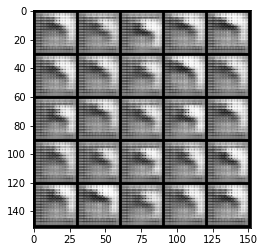

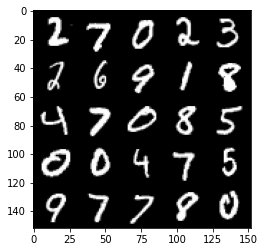

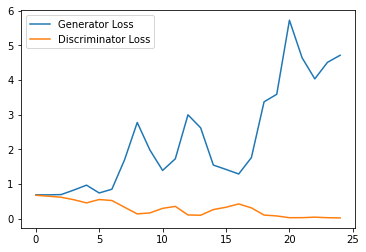

Step 1000: Generator loss: 3.5021089246273043, discriminator loss: 0.1306115567740053


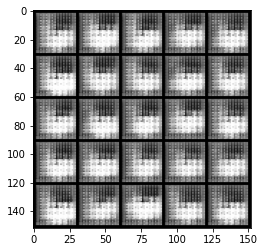

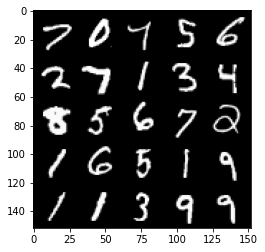

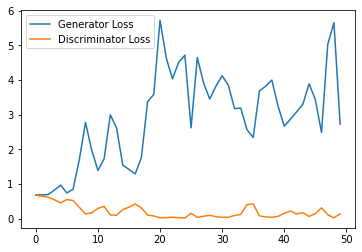

Step 1500: Generator loss: 3.4181993243694304, discriminator loss: 0.14393277011066674


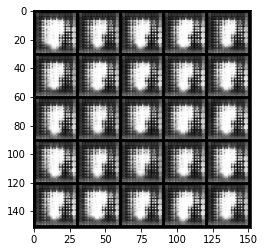

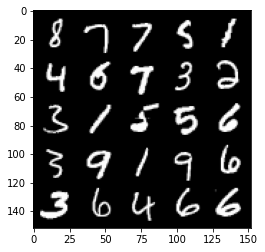

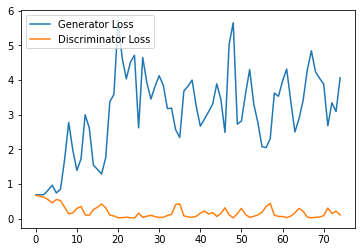

Step 2000: Generator loss: 4.2426348695755, discriminator loss: 0.04630699121300131


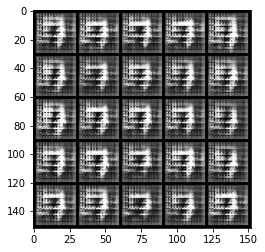

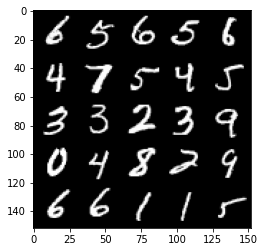

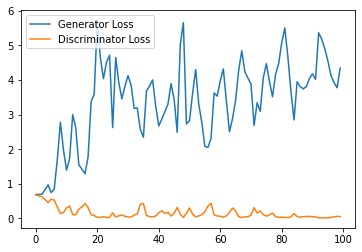

Step 2500: Generator loss: 3.481681411266327, discriminator loss: 0.10840693954750895


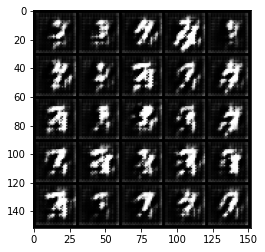

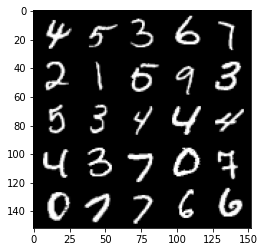

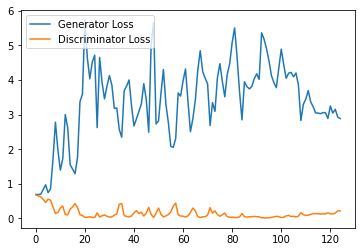

Step 3000: Generator loss: 2.9043138570785523, discriminator loss: 0.2128109386563301


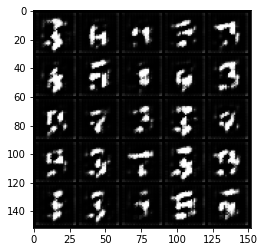

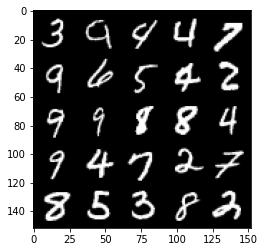

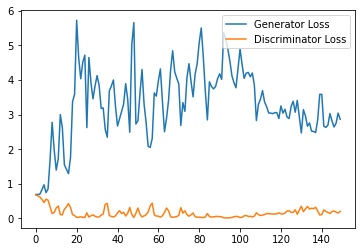

Step 3500: Generator loss: 2.306903425216675, discriminator loss: 0.2640973384529352


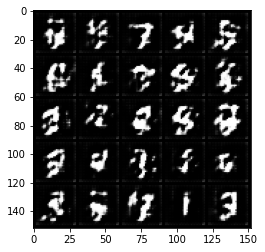

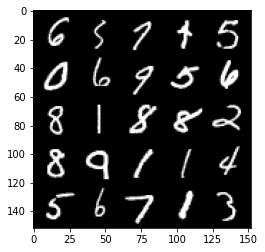

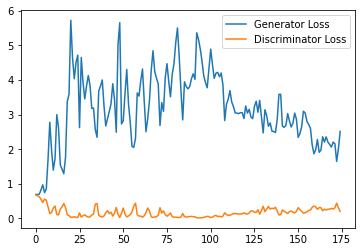

Step 4000: Generator loss: 2.08914549612999, discriminator loss: 0.3622893714904785


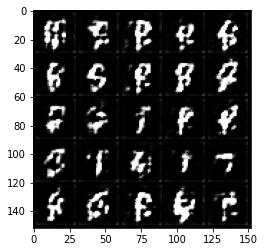

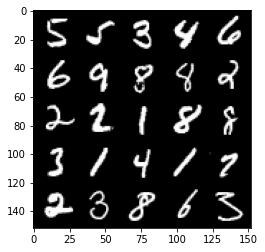

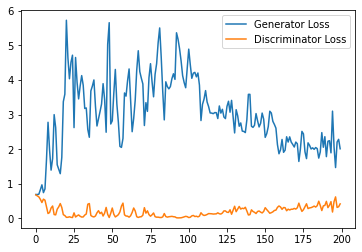

Step 4500: Generator loss: 1.8925752050876616, discriminator loss: 0.39490188875794413


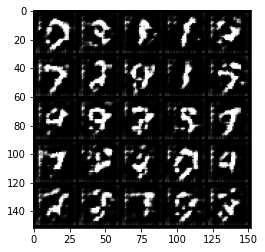

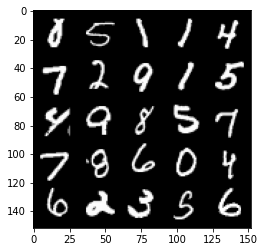

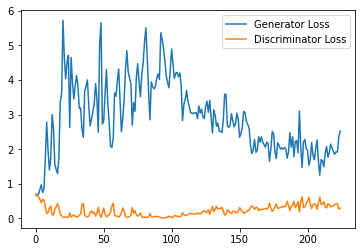

Step 5000: Generator loss: 1.920212200164795, discriminator loss: 0.3429356843829155


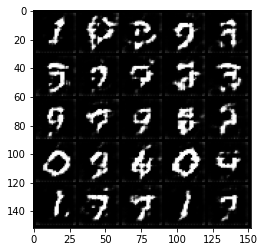

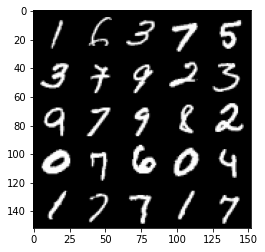

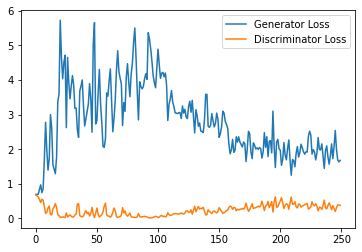

Step 5500: Generator loss: 1.9650368144512176, discriminator loss: 0.3406832346320152


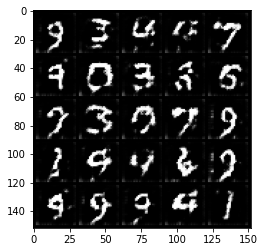

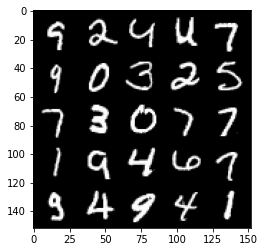

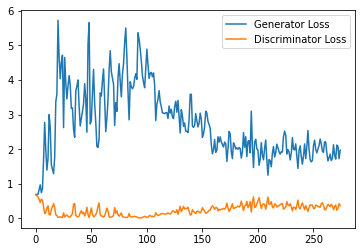

Step 6000: Generator loss: 1.854819096326828, discriminator loss: 0.3366893875300884


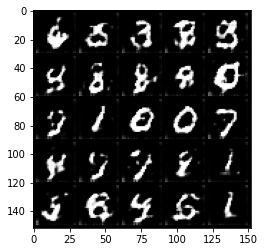

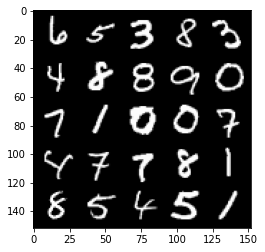

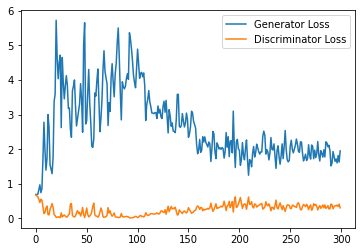

Step 6500: Generator loss: 1.863849208831787, discriminator loss: 0.3961902073025703


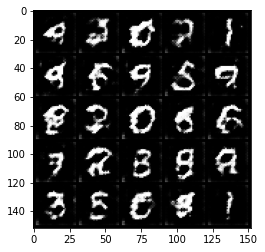

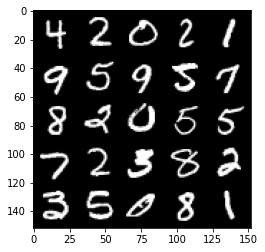

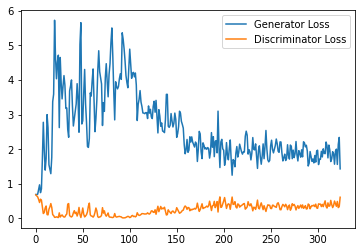

Step 7000: Generator loss: 1.7527639558315278, discriminator loss: 0.407521252989769


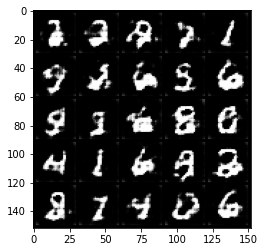

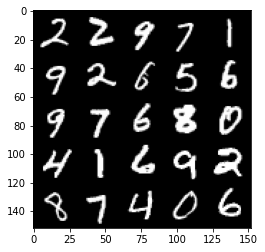

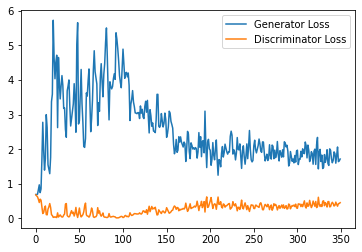

Step 7500: Generator loss: 1.6508797632455825, discriminator loss: 0.4332661110162735


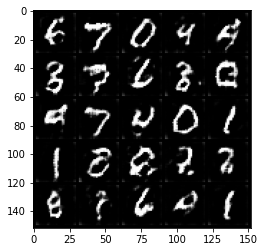

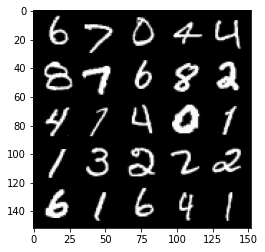

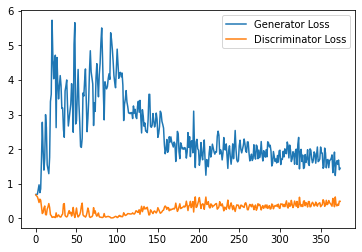

Step 8000: Generator loss: 1.4928814628124236, discriminator loss: 0.46547929364442825


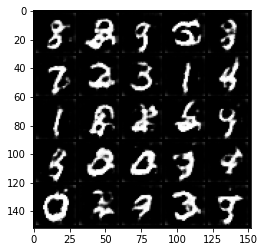

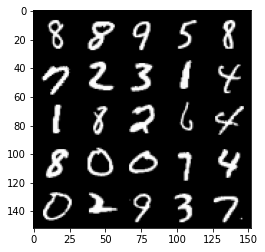

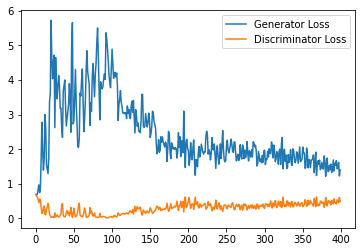

Step 8500: Generator loss: 1.4715650758743286, discriminator loss: 0.45722146493196486


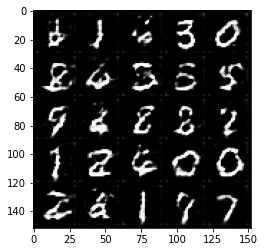

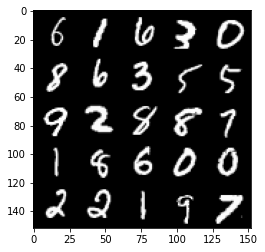

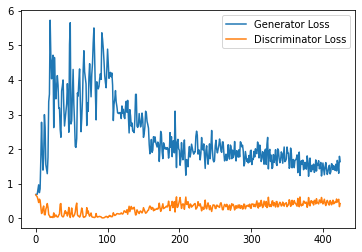

Step 9000: Generator loss: 1.3867502024173737, discriminator loss: 0.48903441315889357


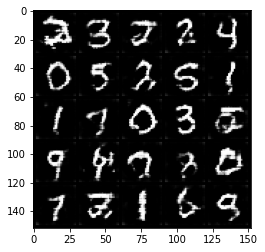

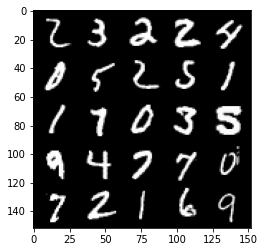

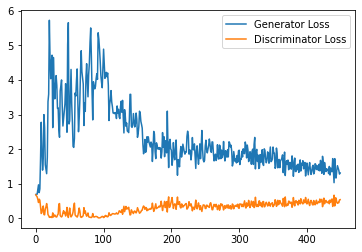

Step 9500: Generator loss: 1.3431210126876831, discriminator loss: 0.5057627775073051


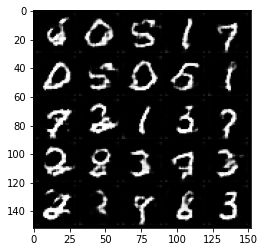

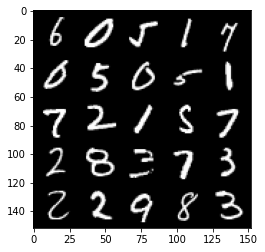

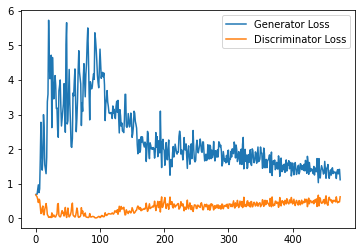

Step 10000: Generator loss: 1.2864102029800415, discriminator loss: 0.5046419631242752


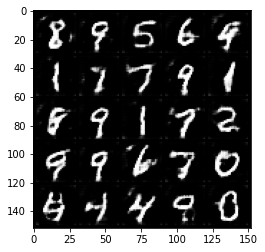

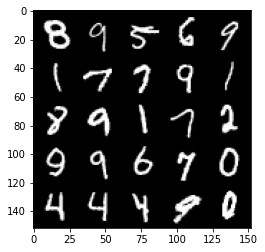

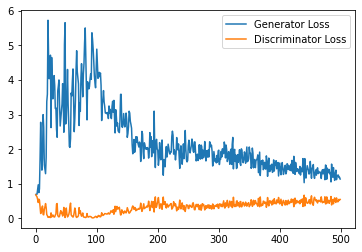

Step 10500: Generator loss: 1.24870918571949, discriminator loss: 0.526633196413517


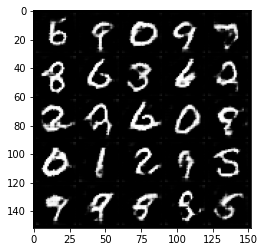

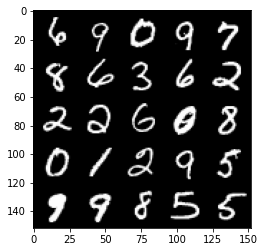

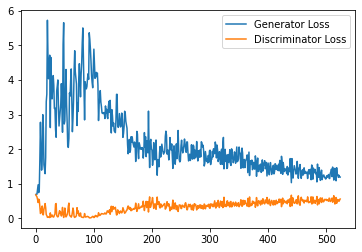

Step 11000: Generator loss: 1.276636142015457, discriminator loss: 0.5329544252753258


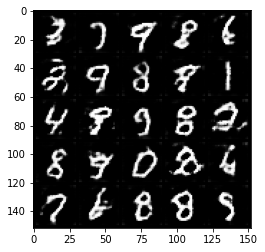

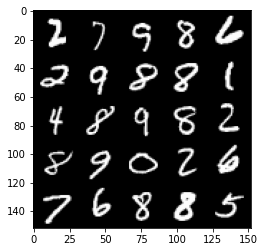

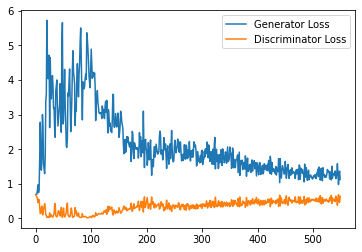

Step 11500: Generator loss: 1.2340594338178634, discriminator loss: 0.538300911962986


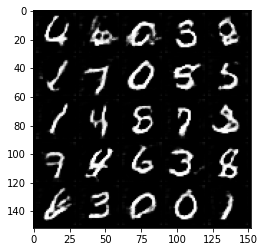

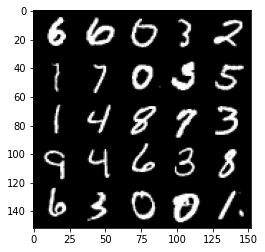

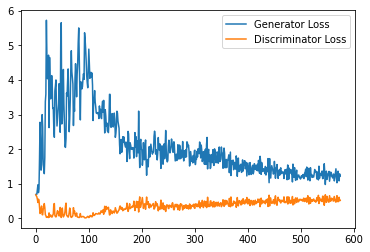

Step 12000: Generator loss: 1.1990817363262176, discriminator loss: 0.5434463978409767


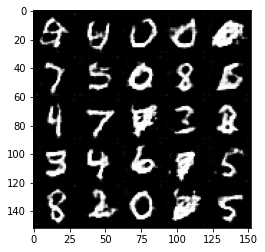

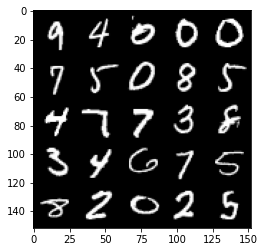

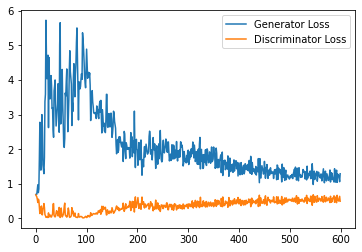

Step 12500: Generator loss: 1.2236514737606048, discriminator loss: 0.5540356940627098


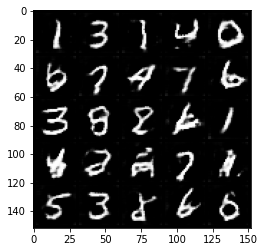

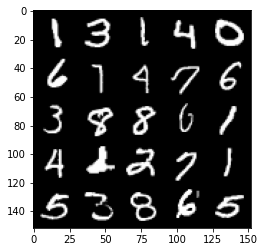

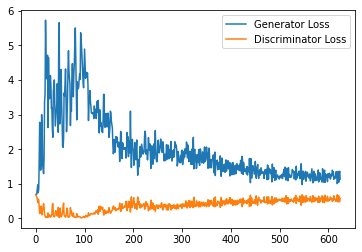

Step 13000: Generator loss: 1.0916831481456757, discriminator loss: 0.5675537195205689


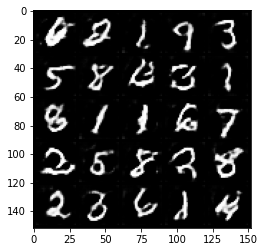

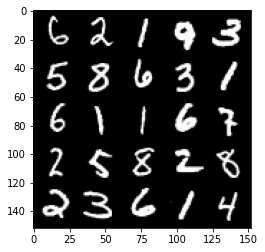

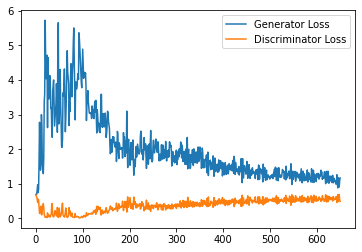

Step 13500: Generator loss: 1.1006756306886674, discriminator loss: 0.5703778205513954


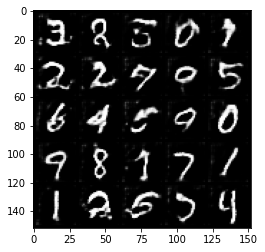

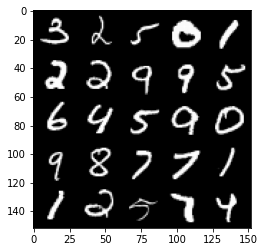

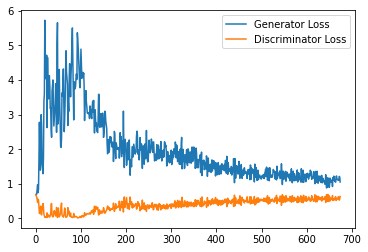

Step 14000: Generator loss: 1.1049751940965653, discriminator loss: 0.584122742831707


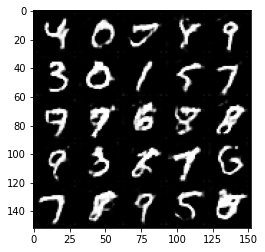

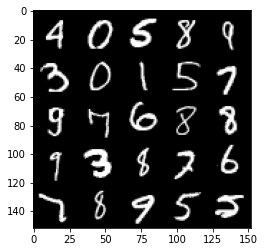

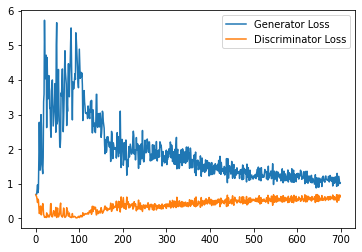

Step 14500: Generator loss: 1.0836310187578202, discriminator loss: 0.5745148755908013


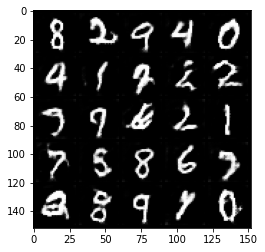

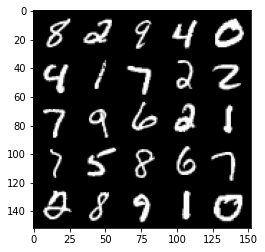

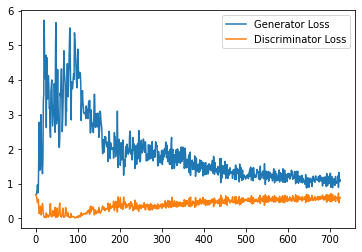

Step 15000: Generator loss: 1.0915544934272765, discriminator loss: 0.5796201281547546


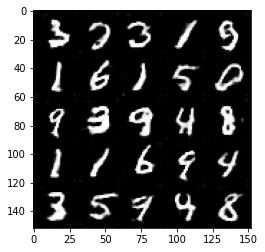

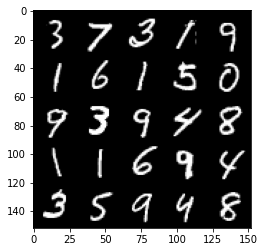

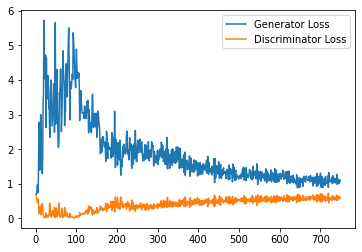

Step 15500: Generator loss: 1.0423250387907028, discriminator loss: 0.5786203513145447


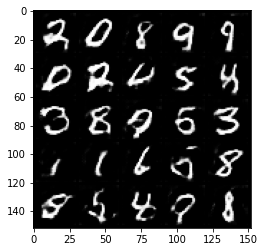

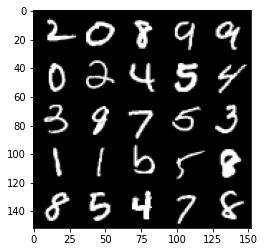

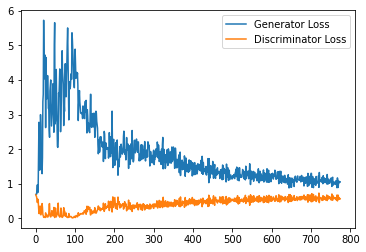

Step 16000: Generator loss: 1.068233099579811, discriminator loss: 0.5805581675171853


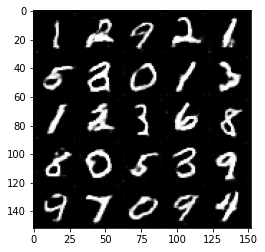

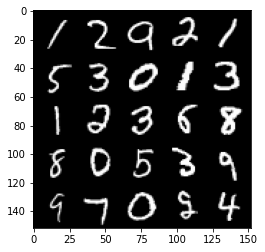

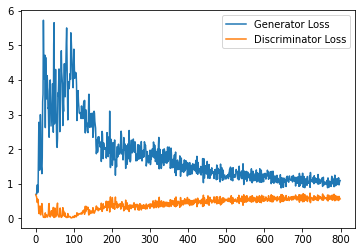

Step 16500: Generator loss: 1.0641130349636079, discriminator loss: 0.5853752489686013


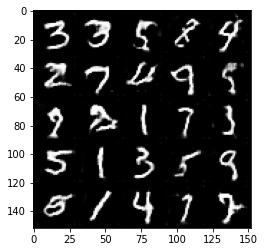

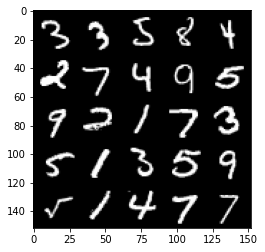

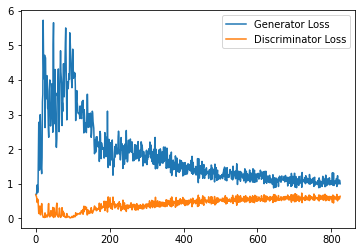

Step 17000: Generator loss: 1.051459765315056, discriminator loss: 0.5867133008837699


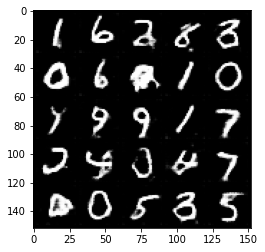

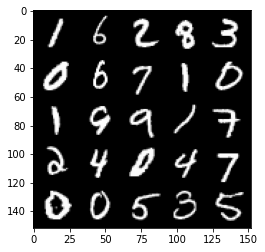

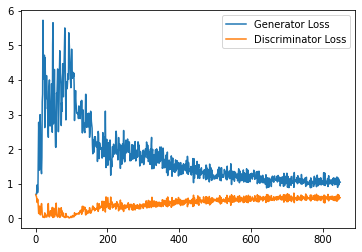

Step 17500: Generator loss: 1.036855005145073, discriminator loss: 0.5969174277186394


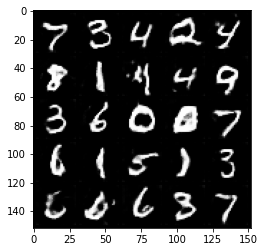

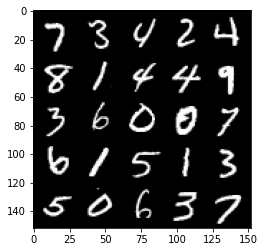

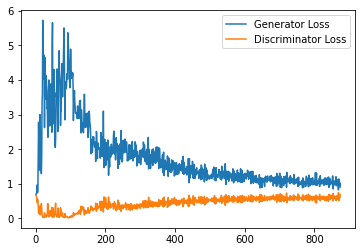

Step 18000: Generator loss: 1.0232566077709198, discriminator loss: 0.5972193349599838


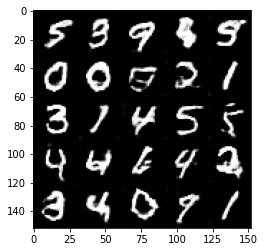

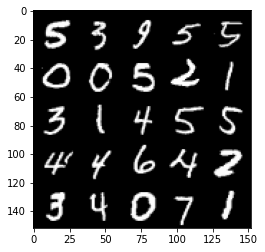

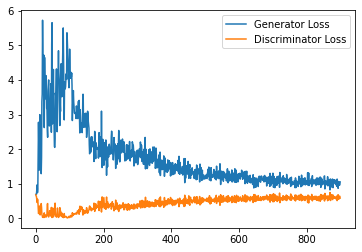

Step 18500: Generator loss: 1.0340783739089965, discriminator loss: 0.5976787381172181


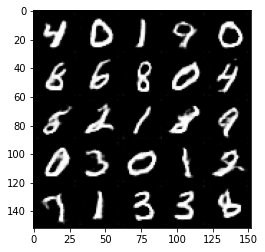

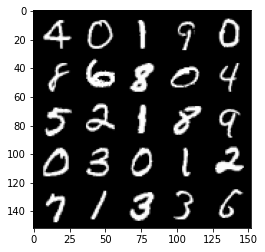

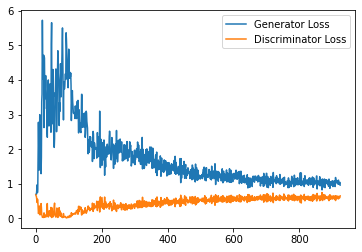

Step 19000: Generator loss: 1.013794333100319, discriminator loss: 0.5965818296670914


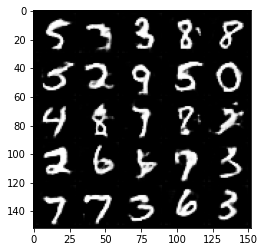

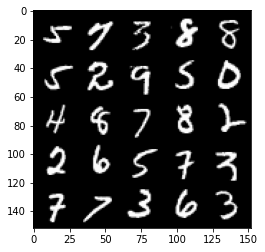

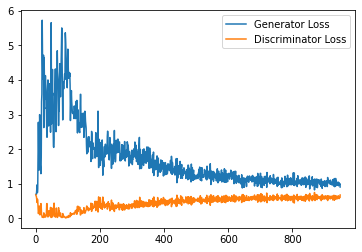

Step 19500: Generator loss: 1.0027813448905945, discriminator loss: 0.5959023502469063


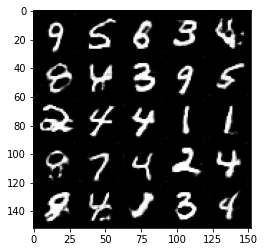

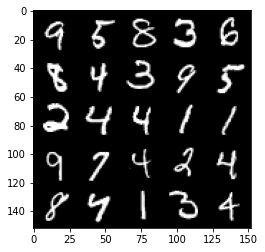

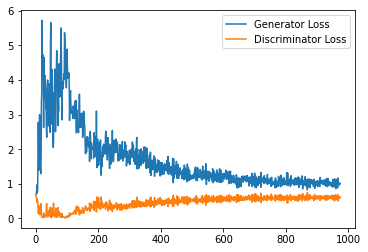

Step 20000: Generator loss: 1.0015945640802384, discriminator loss: 0.6020334385037422


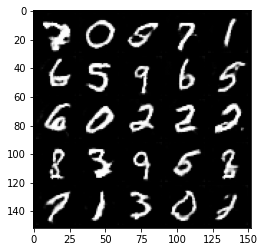

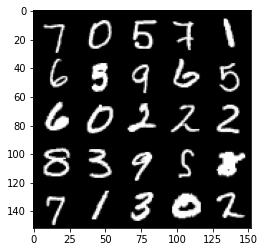

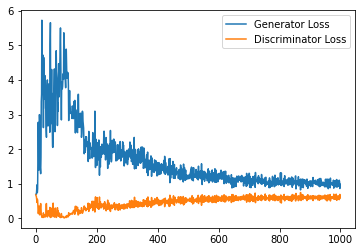

Step 20500: Generator loss: 0.976148362994194, discriminator loss: 0.6014640652537346


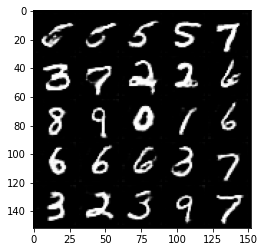

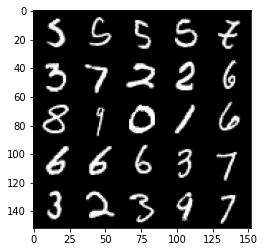

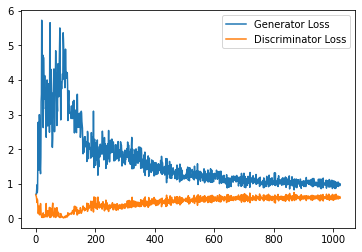

Step 21000: Generator loss: 1.0062220355272293, discriminator loss: 0.6004644134044648


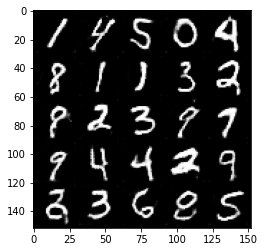

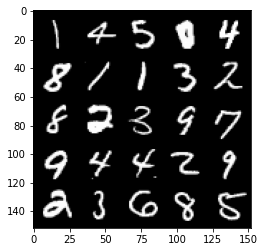

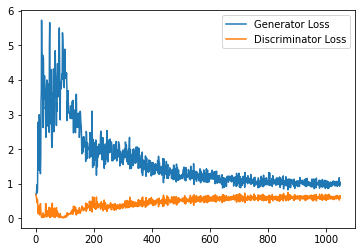

Step 21500: Generator loss: 0.9789887659549713, discriminator loss: 0.6069025531411171


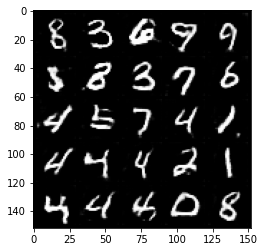

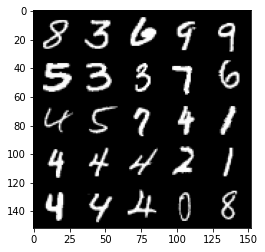

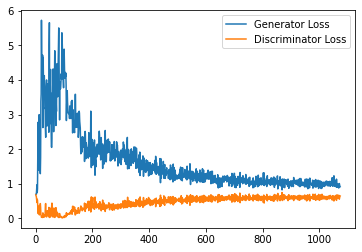

Step 22000: Generator loss: 0.9744240254163742, discriminator loss: 0.6033550139069557


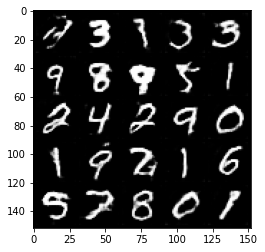

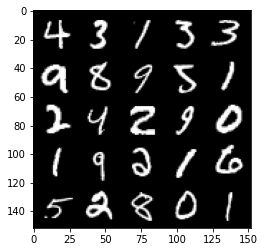

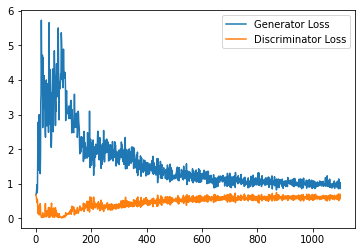

Step 22500: Generator loss: 0.9999665063619614, discriminator loss: 0.6043513191342353


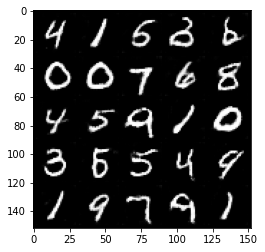

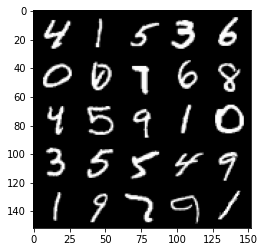

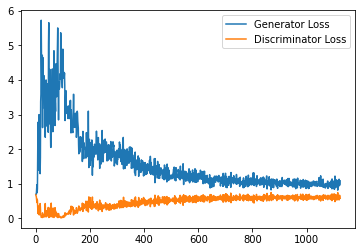

Step 23000: Generator loss: 1.0009975583553314, discriminator loss: 0.6092479558587074


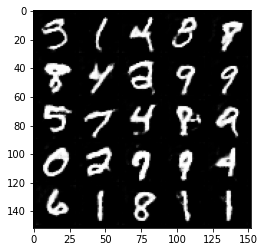

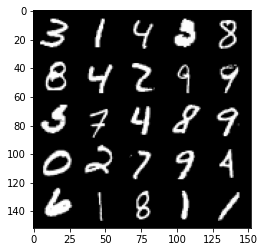

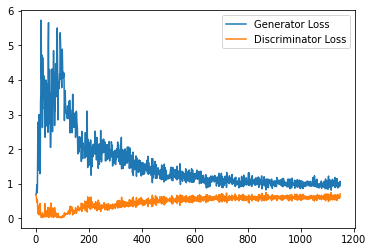

Step 23500: Generator loss: 0.9821540025472641, discriminator loss: 0.5992584317326546


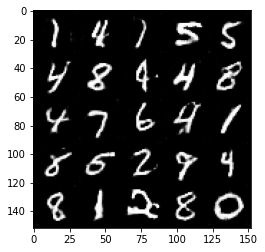

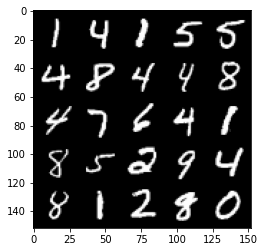

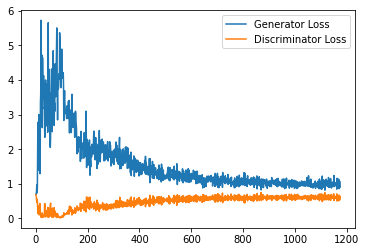

Step 24000: Generator loss: 0.9628066394329071, discriminator loss: 0.6031892787218094


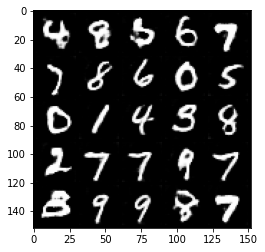

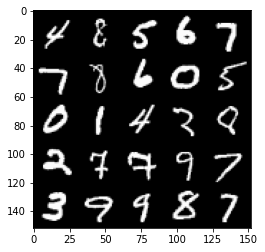

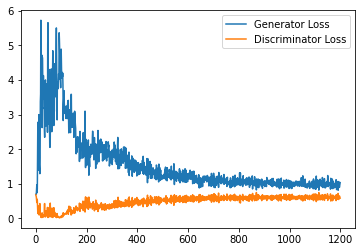

Step 24500: Generator loss: 0.9799397271871567, discriminator loss: 0.6027051808834076


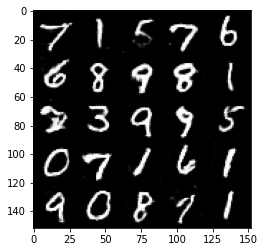

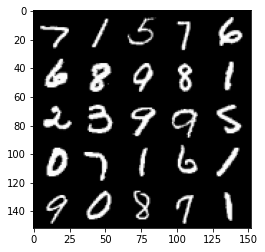

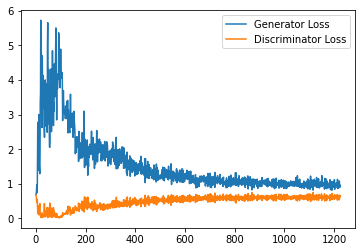

Step 25000: Generator loss: 0.9784850956201553, discriminator loss: 0.6068970490694046


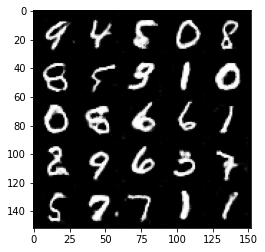

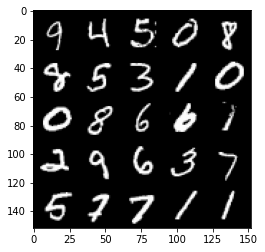

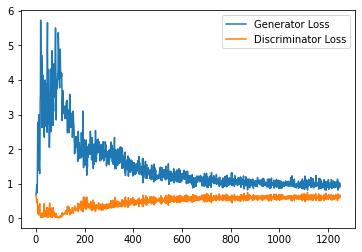

Step 25500: Generator loss: 0.96669888317585, discriminator loss: 0.6084215826988221


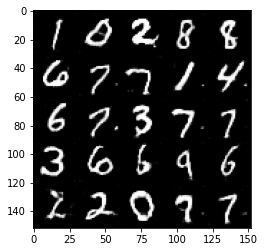

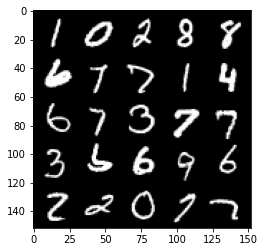

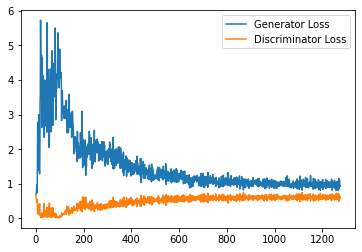

Step 26000: Generator loss: 0.9574041056632996, discriminator loss: 0.613502961397171


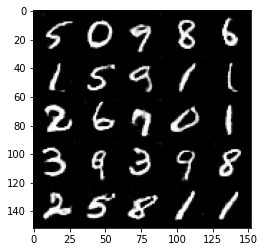

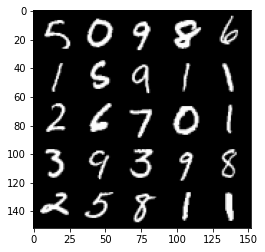

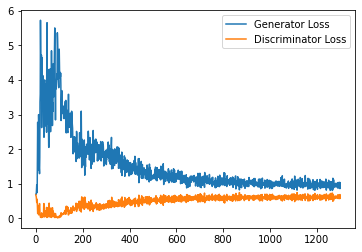

Step 26500: Generator loss: 0.9609147543907166, discriminator loss: 0.6121795753240585


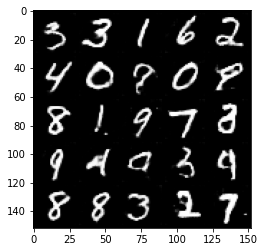

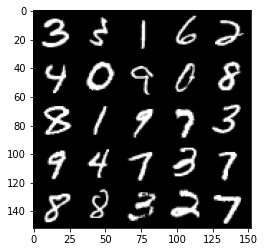

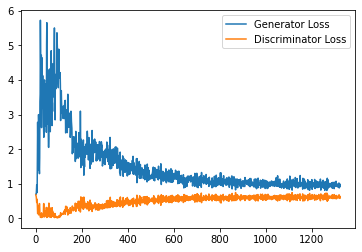

Step 27000: Generator loss: 0.9523373997211456, discriminator loss: 0.6186950204968452


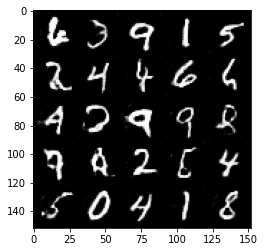

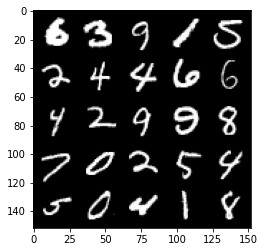

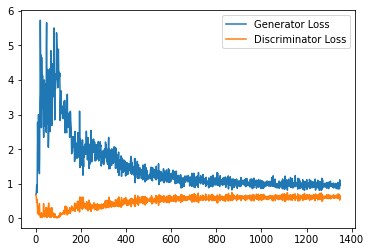

Step 27500: Generator loss: 0.9632802329063416, discriminator loss: 0.6127566863298416


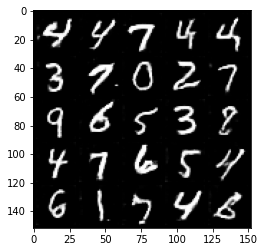

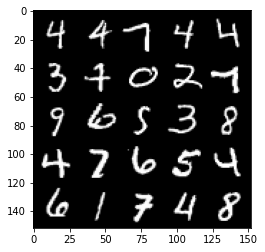

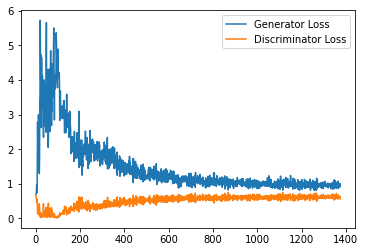

Step 28000: Generator loss: 0.9292155629396439, discriminator loss: 0.6170026014447212


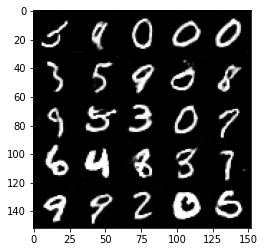

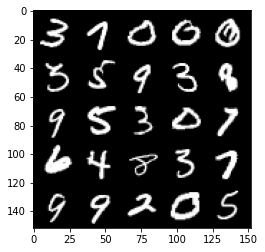

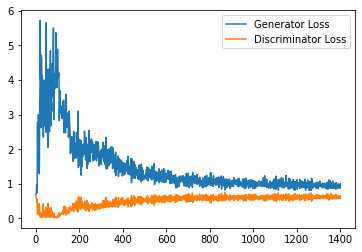

Step 28500: Generator loss: 0.9415322390794754, discriminator loss: 0.6183060238361359


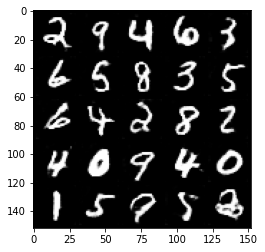

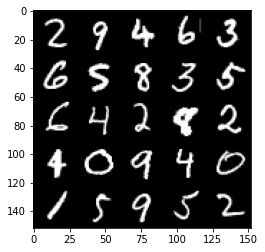

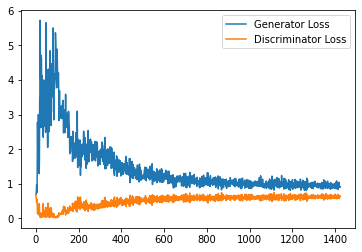

Step 29000: Generator loss: 0.9333738324642181, discriminator loss: 0.6157725952863693


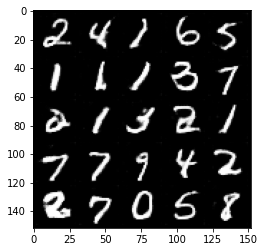

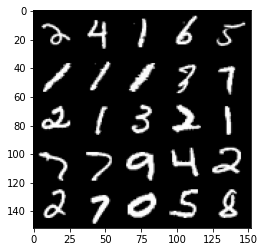

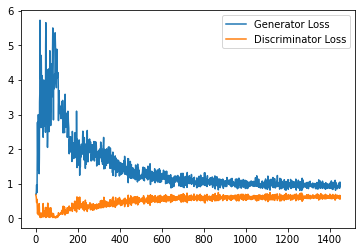

Step 29500: Generator loss: 0.9415651144981384, discriminator loss: 0.6205894007682801


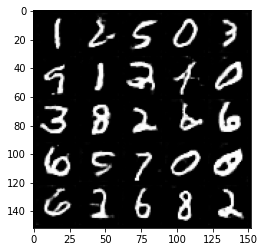

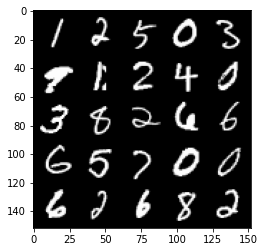

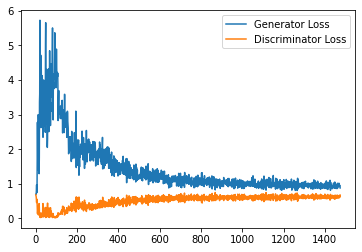

Step 30000: Generator loss: 0.9217150497436524, discriminator loss: 0.6250345257520675


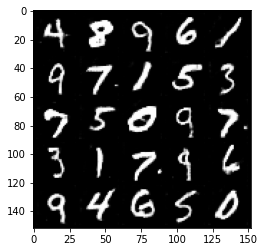

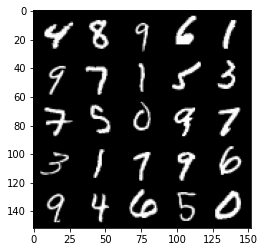

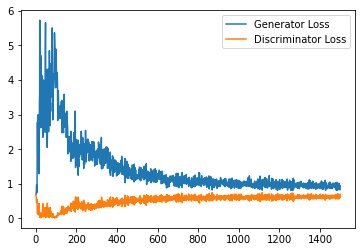

Step 30500: Generator loss: 0.9392448843717575, discriminator loss: 0.6196523169875146


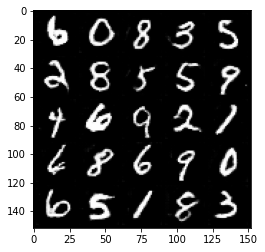

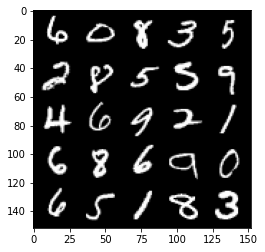

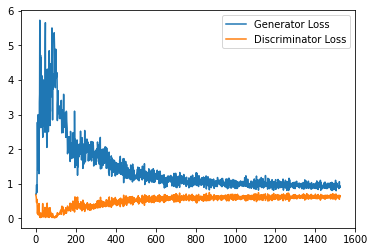

Step 31000: Generator loss: 0.9256798939704896, discriminator loss: 0.6192947977781296


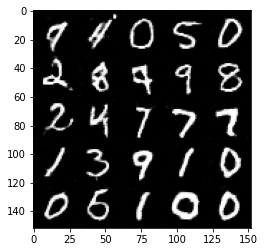

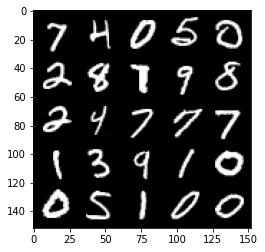

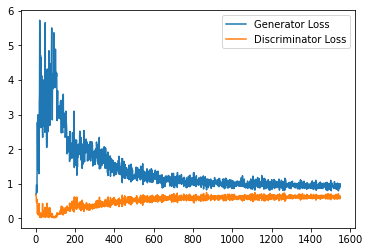

Step 31500: Generator loss: 0.9078765097856522, discriminator loss: 0.6240191437005996


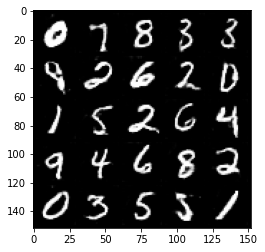

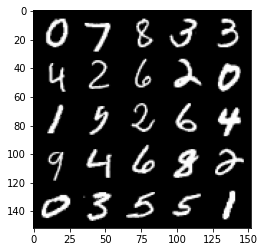

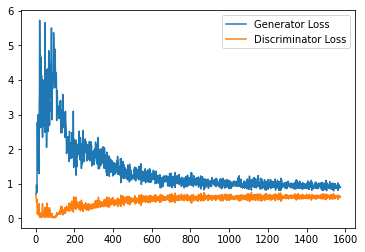

Step 32000: Generator loss: 0.9178351013660431, discriminator loss: 0.6241124535799026


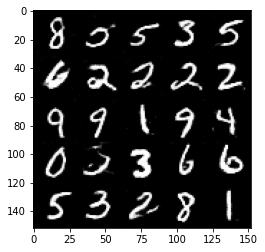

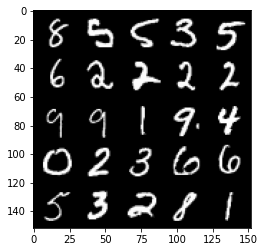

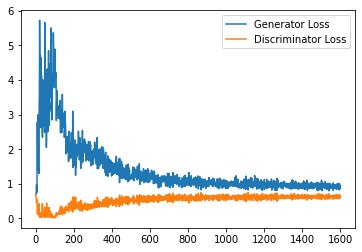

Step 32500: Generator loss: 0.9252684086561203, discriminator loss: 0.6283629261851311


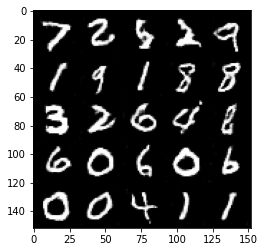

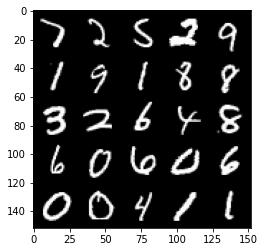

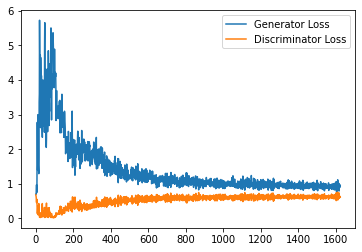

Step 33000: Generator loss: 0.9328590404987335, discriminator loss: 0.6235867263078689


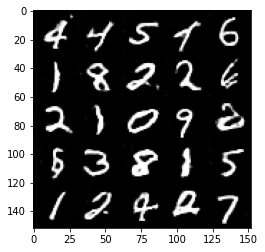

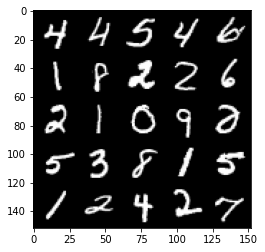

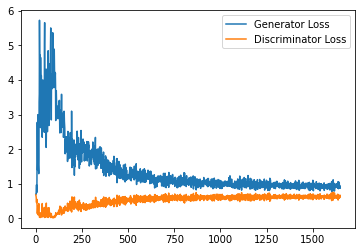

Step 33500: Generator loss: 0.9158703892230987, discriminator loss: 0.6219004856348038


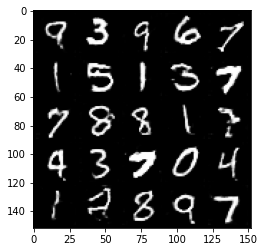

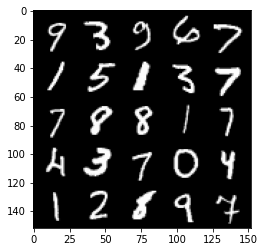

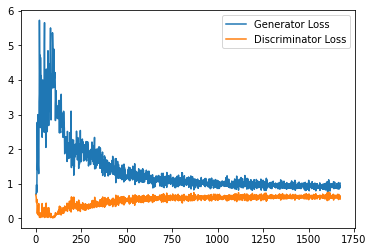

Step 34000: Generator loss: 0.9249586682319642, discriminator loss: 0.6228857043385506


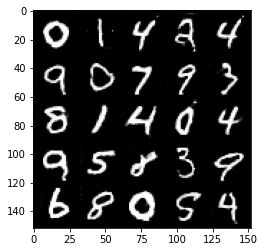

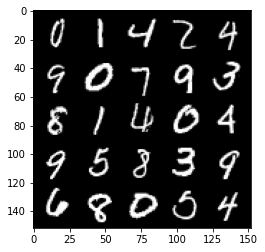

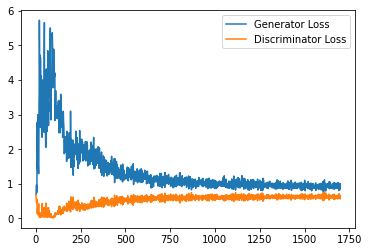

Step 34500: Generator loss: 0.9168216798305512, discriminator loss: 0.6225968549847603


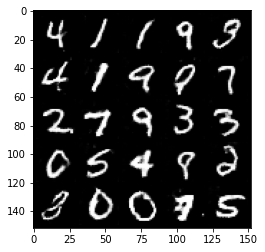

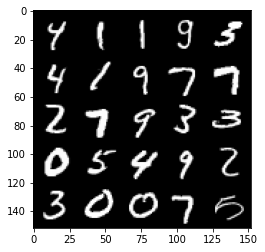

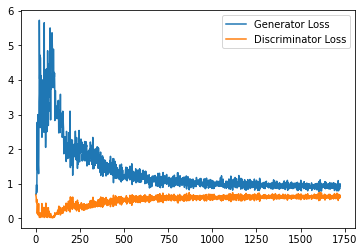

Step 35000: Generator loss: 0.9115046957731247, discriminator loss: 0.6260407000780106


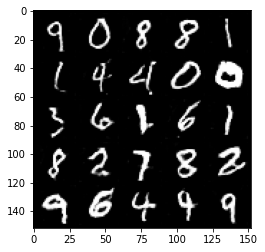

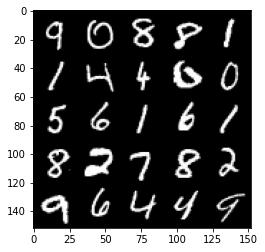

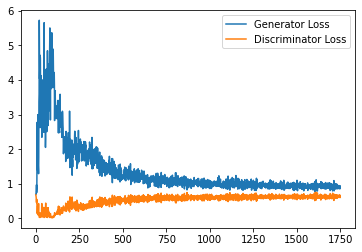

Step 35500: Generator loss: 0.895885528922081, discriminator loss: 0.6305326880216598


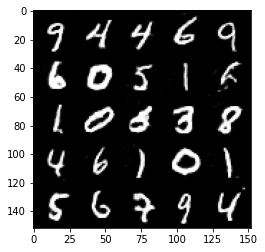

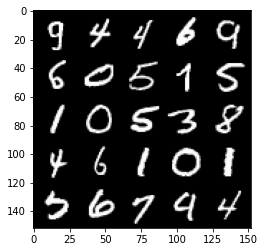

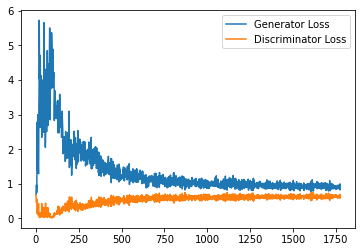

Step 36000: Generator loss: 0.9347986075878143, discriminator loss: 0.6249888473749161


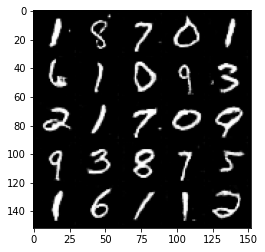

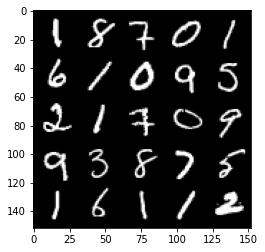

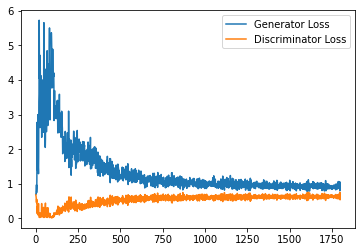

Step 36500: Generator loss: 0.9291949362754822, discriminator loss: 0.628373908340931


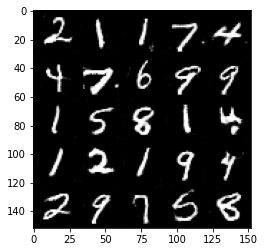

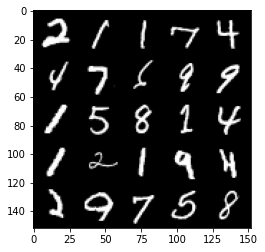

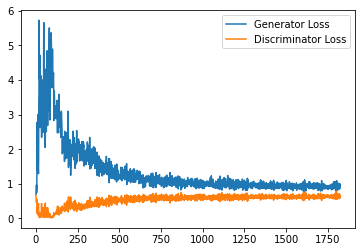

Step 37000: Generator loss: 0.9098495007753372, discriminator loss: 0.6259054654836654


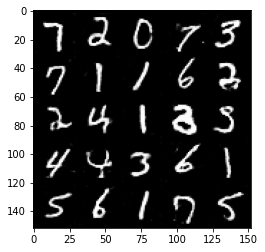

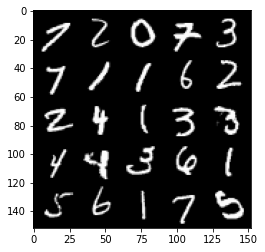

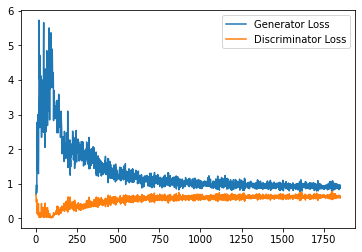

Step 37500: Generator loss: 0.8935382124185562, discriminator loss: 0.6262548252344131


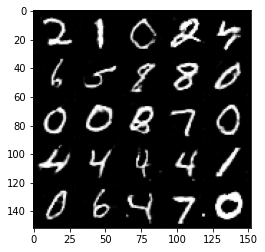

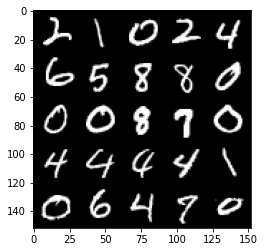

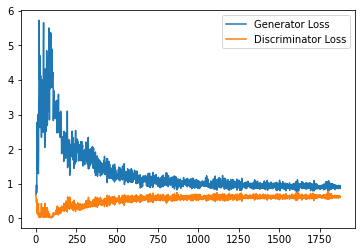

Step 38000: Generator loss: 0.9139124763011932, discriminator loss: 0.6271901053190231


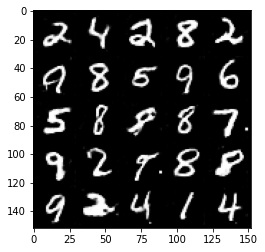

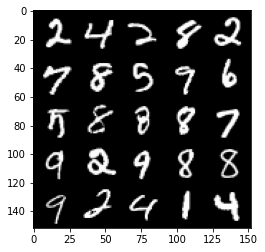

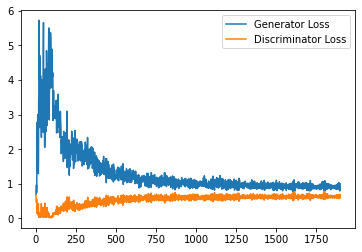

Step 38500: Generator loss: 0.9116416275501251, discriminator loss: 0.6345009986758232


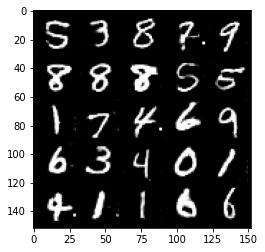

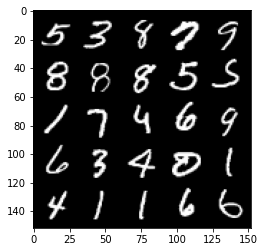

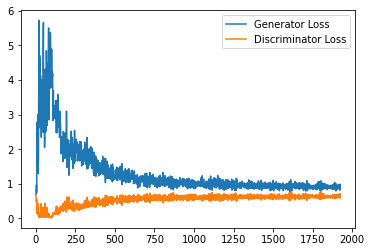

Step 39000: Generator loss: 0.9202777067422867, discriminator loss: 0.6286410066485405


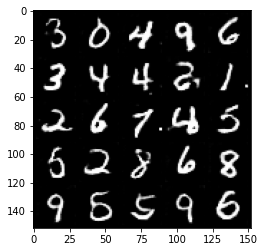

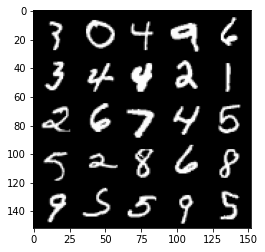

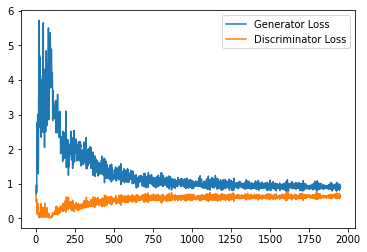

Step 39500: Generator loss: 0.9006068720817566, discriminator loss: 0.631147138953209


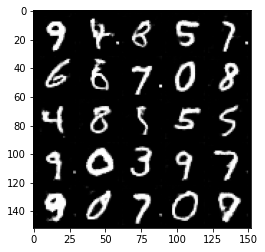

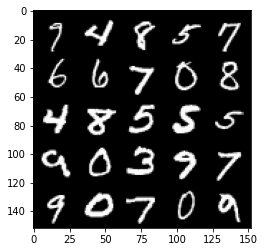

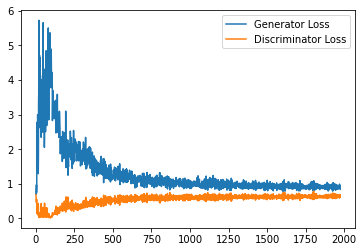

Step 40000: Generator loss: 0.9433281314373017, discriminator loss: 0.629959183216095


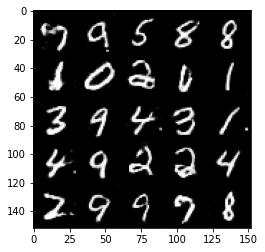

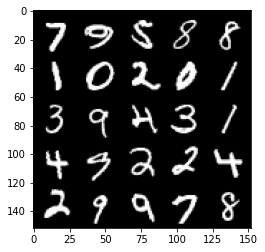

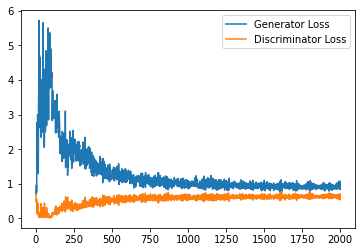

Step 40500: Generator loss: 0.9138090839385986, discriminator loss: 0.6308948163986206


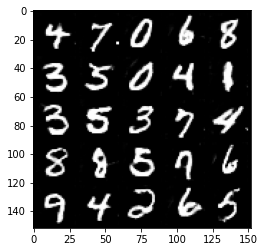

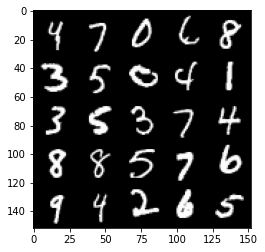

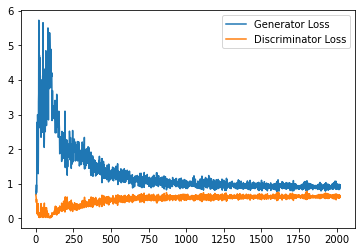

Step 41000: Generator loss: 0.9029134266376495, discriminator loss: 0.6243042251467705


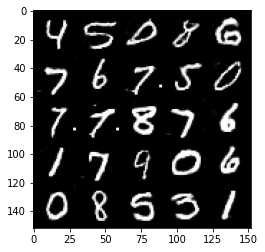

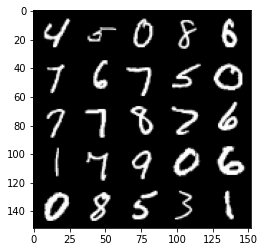

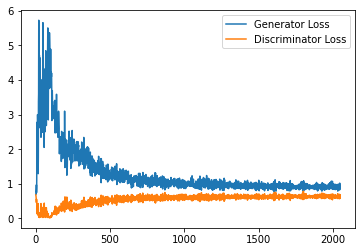

Step 41500: Generator loss: 0.9073941819667816, discriminator loss: 0.6264961614608765


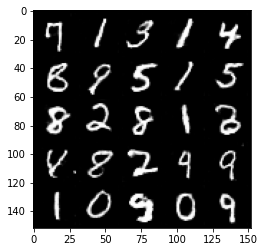

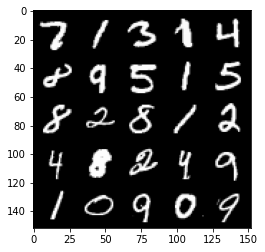

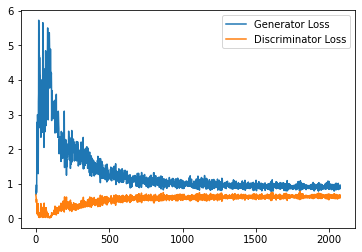

Step 42000: Generator loss: 0.8936954973936081, discriminator loss: 0.6274717375040054


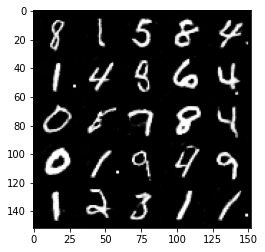

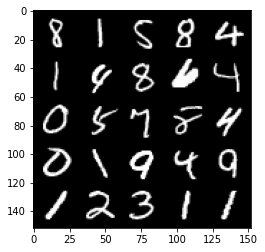

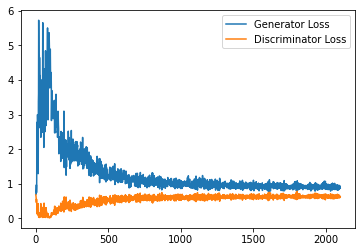

Step 42500: Generator loss: 0.8831457086801529, discriminator loss: 0.624067255973816


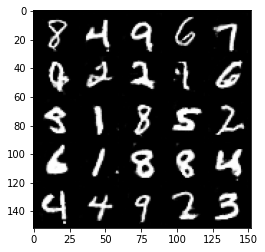

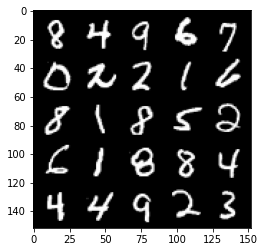

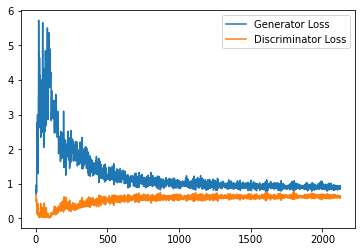

Step 43000: Generator loss: 0.9125791321992874, discriminator loss: 0.624814453959465


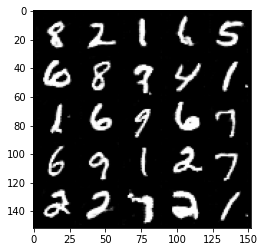

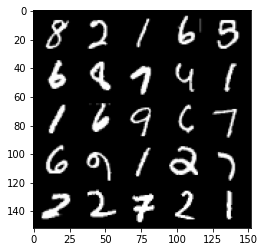

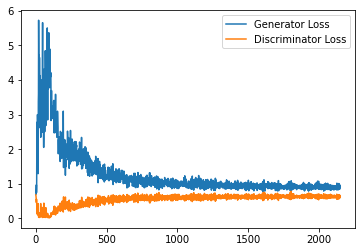

Step 43500: Generator loss: 0.9113633809089661, discriminator loss: 0.6212695685625076


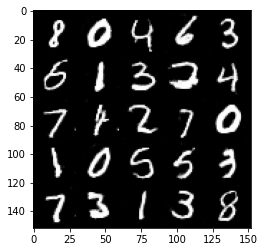

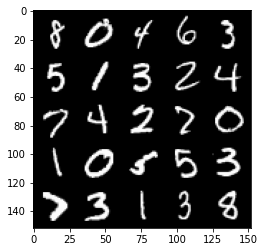

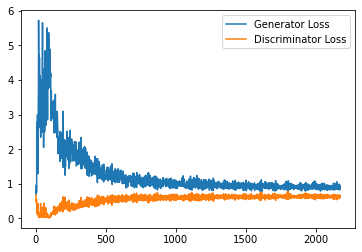

Step 44000: Generator loss: 0.9191097252368927, discriminator loss: 0.6258974573612213


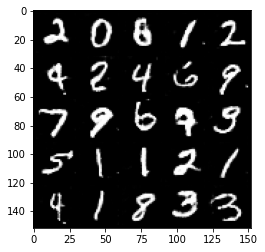

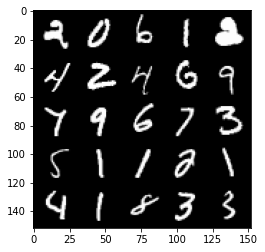

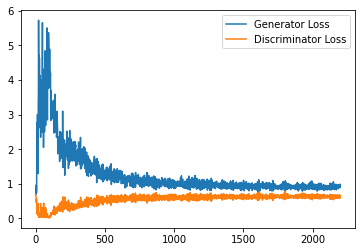

Step 44500: Generator loss: 0.9149323308467865, discriminator loss: 0.6287429597973824


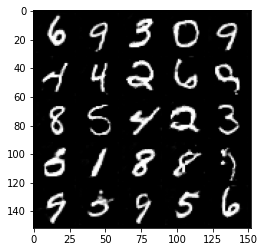

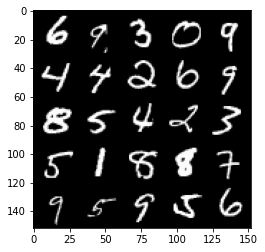

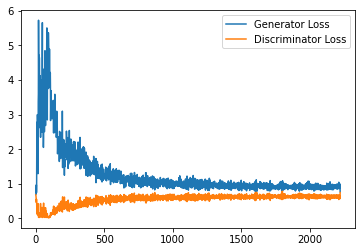

Step 45000: Generator loss: 0.9208981442451477, discriminator loss: 0.6250517255067826


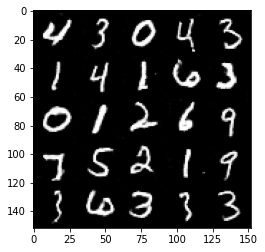

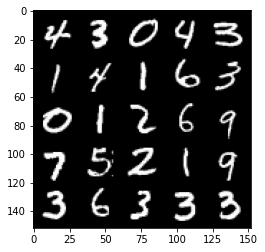

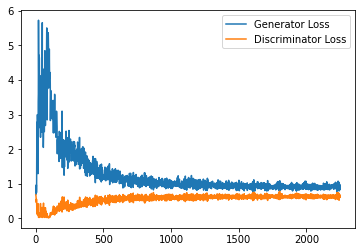

Step 45500: Generator loss: 0.9342296626567841, discriminator loss: 0.6202806875705719


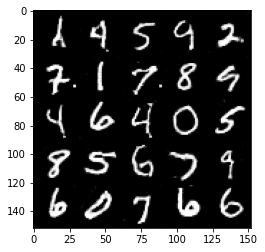

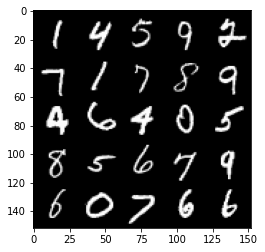

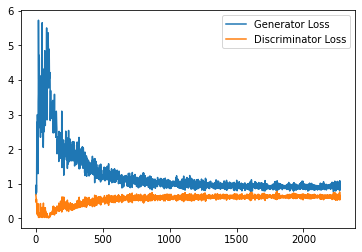

Step 46000: Generator loss: 0.8988355520963669, discriminator loss: 0.6254224600791931


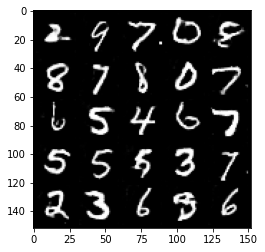

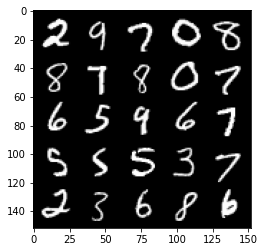

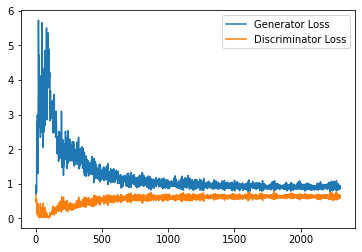

Step 46500: Generator loss: 0.9003508571386337, discriminator loss: 0.6211010743379592


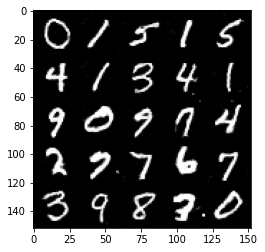

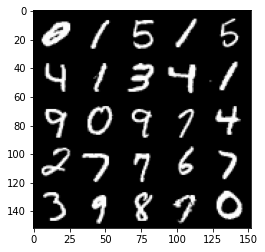

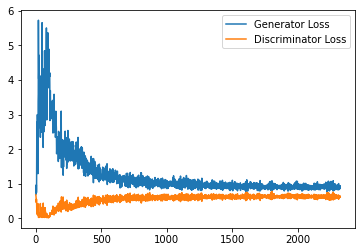

Step 47000: Generator loss: 0.9183925142288208, discriminator loss: 0.6276008586883545


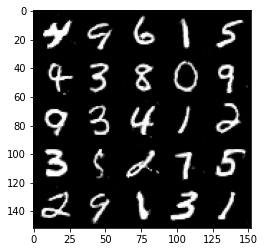

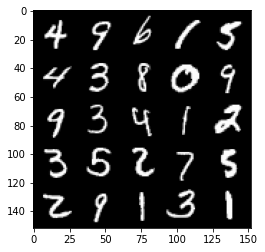

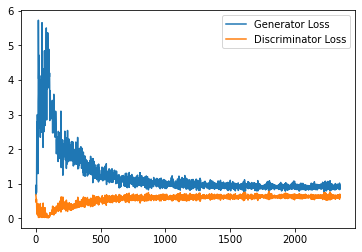

Step 47500: Generator loss: 0.920050572514534, discriminator loss: 0.6242861652374267


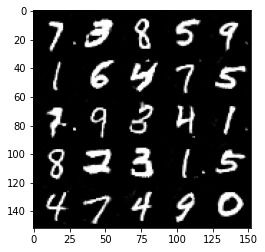

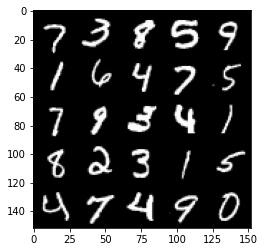

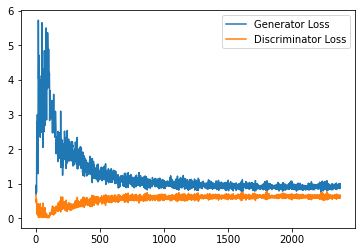

Step 48000: Generator loss: 0.9105278749465943, discriminator loss: 0.621487886250019


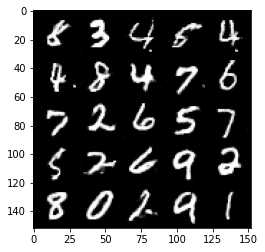

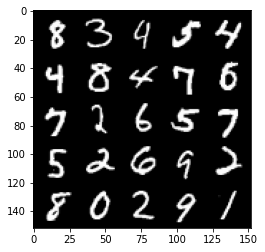

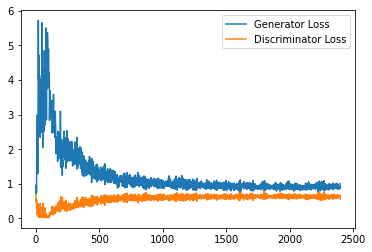

Step 48500: Generator loss: 0.9081653802394867, discriminator loss: 0.6258198059201241


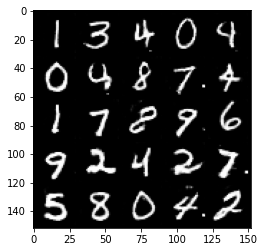

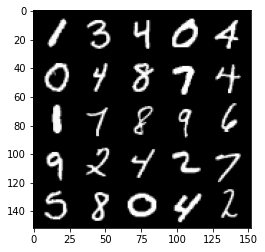

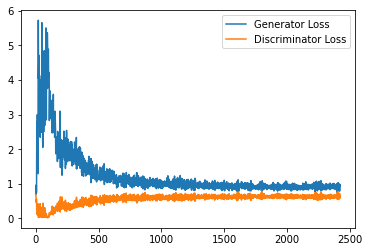

Step 49000: Generator loss: 0.9074240465164185, discriminator loss: 0.6245613921880722


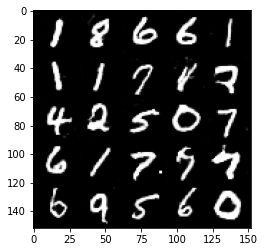

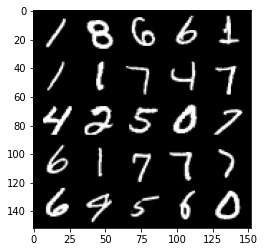

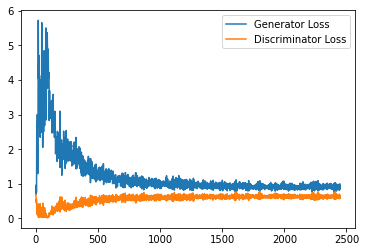

Step 49500: Generator loss: 0.9156370745897293, discriminator loss: 0.6273608492612839


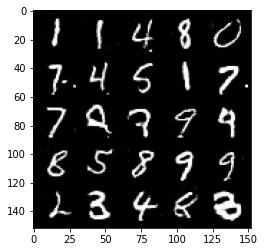

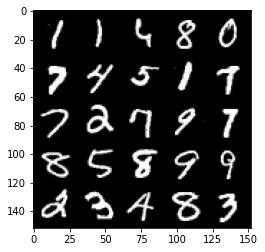

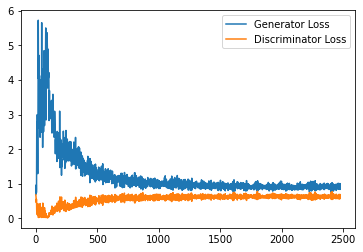

Step 50000: Generator loss: 0.9060438349246979, discriminator loss: 0.6257762551903725


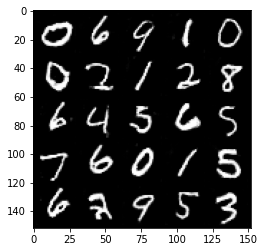

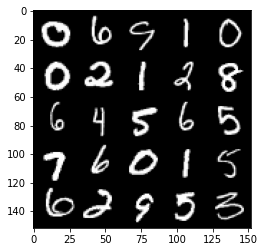

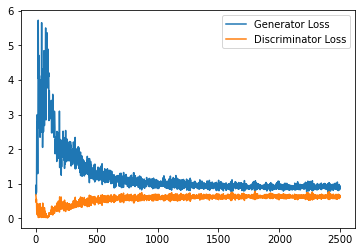

Step 50500: Generator loss: 0.9129571462869644, discriminator loss: 0.6255005674362183


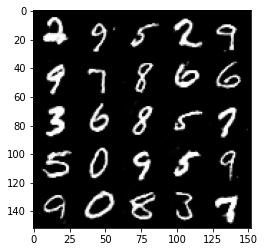

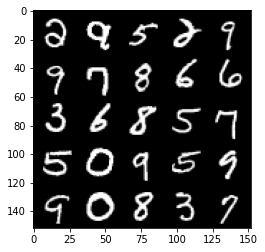

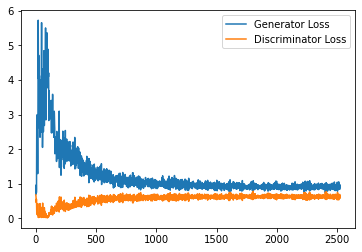

Step 51000: Generator loss: 0.9075574699640274, discriminator loss: 0.6257789128422737


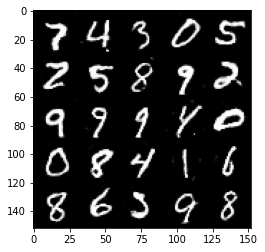

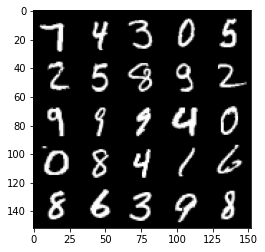

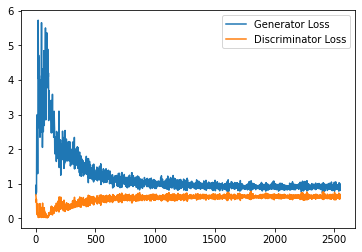

Step 51500: Generator loss: 0.9134597268104553, discriminator loss: 0.6204069958925247


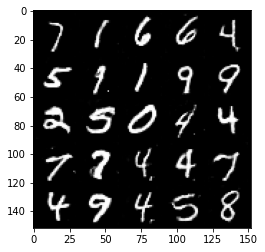

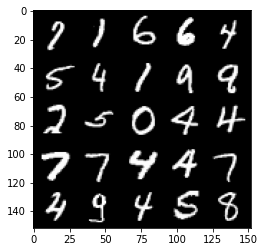

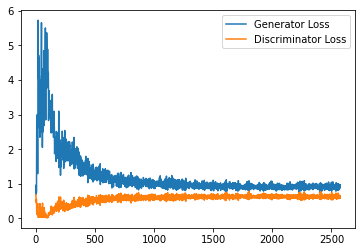

Step 52000: Generator loss: 0.9184784903526306, discriminator loss: 0.623324551820755


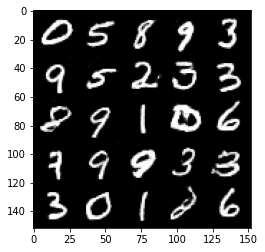

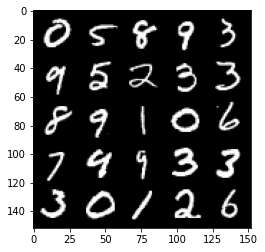

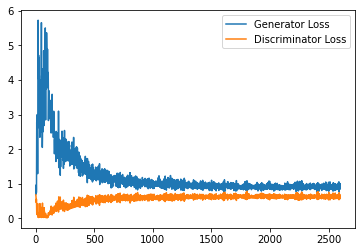

Step 52500: Generator loss: 0.9036130826473237, discriminator loss: 0.6249482583403587


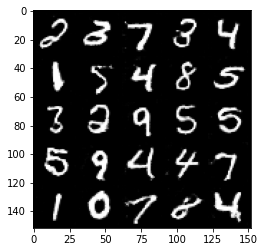

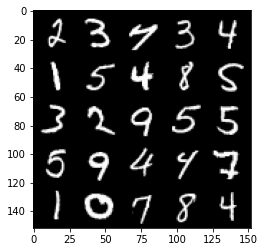

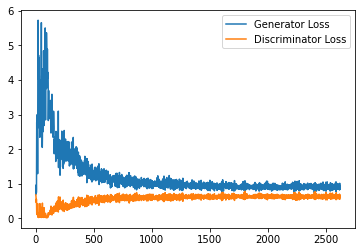

Step 53000: Generator loss: 0.9141605257987976, discriminator loss: 0.6245566937327385


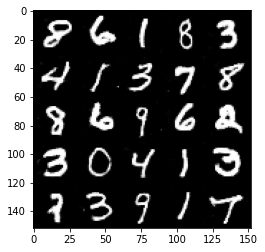

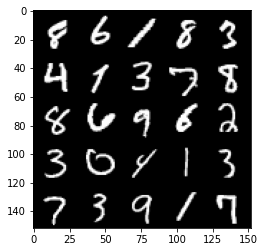

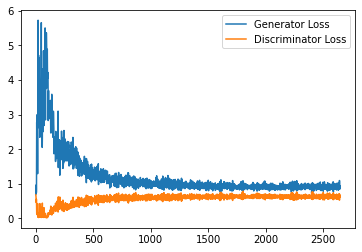

Step 53500: Generator loss: 0.9215739123821258, discriminator loss: 0.6214439605474472


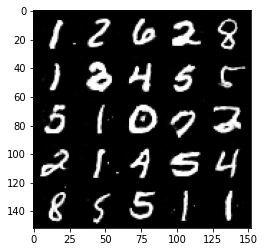

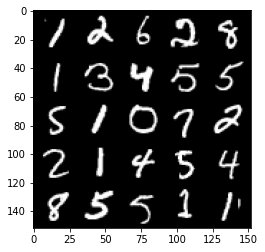

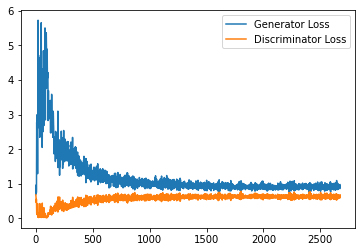

Step 54000: Generator loss: 0.9372995973825454, discriminator loss: 0.6205428519248962


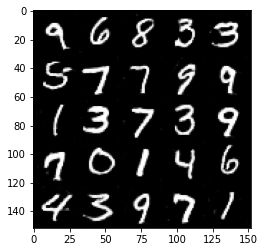

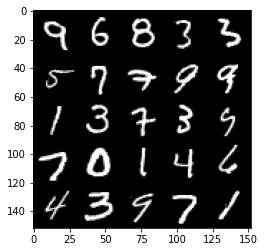

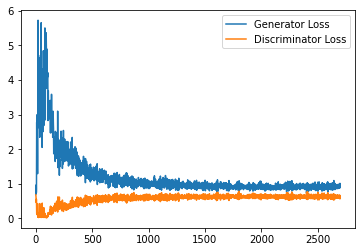

Step 54500: Generator loss: 0.9146924248933792, discriminator loss: 0.6224438819885254


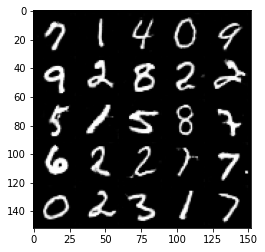

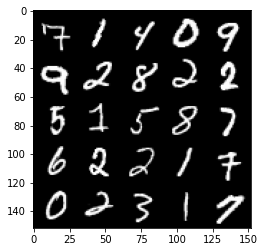

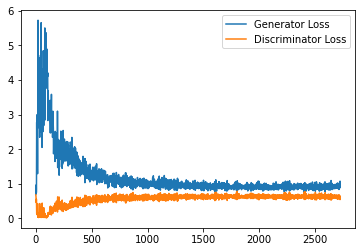

Step 55000: Generator loss: 0.9103780117034912, discriminator loss: 0.6285763243436814


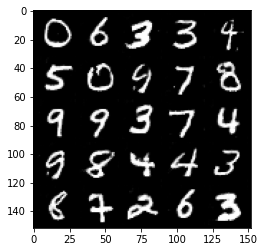

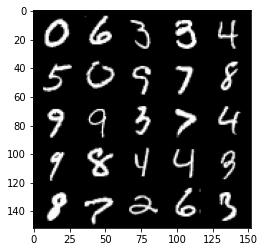

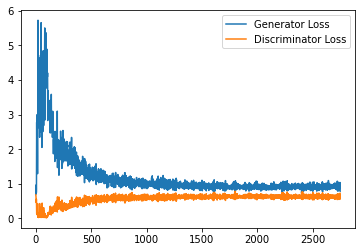

Step 55500: Generator loss: 0.9240473577976227, discriminator loss: 0.6251069718599319


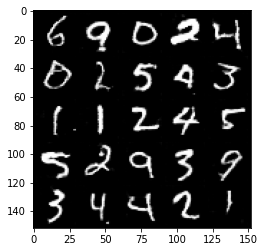

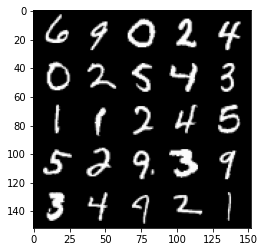

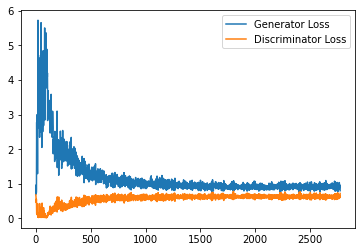

Step 56000: Generator loss: 0.9255119932889938, discriminator loss: 0.6178991105556488


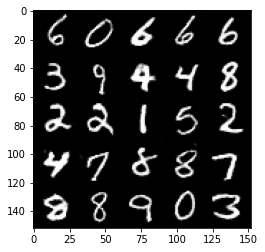

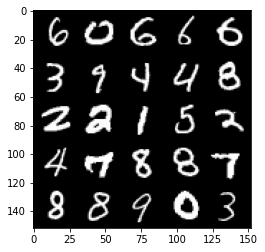

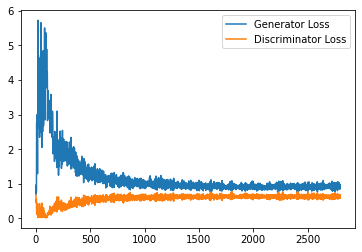

Step 56500: Generator loss: 0.9128592065572738, discriminator loss: 0.6199708153009414


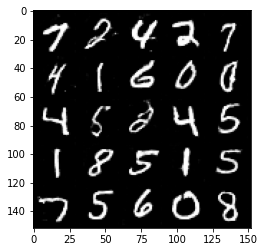

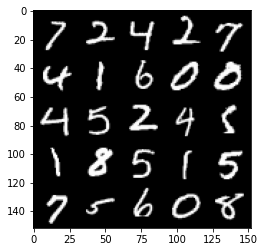

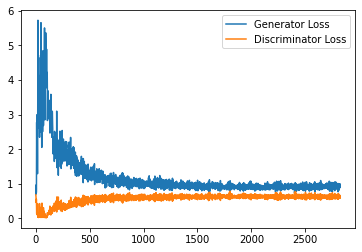

Step 57000: Generator loss: 0.9190253369808197, discriminator loss: 0.6233232382535935


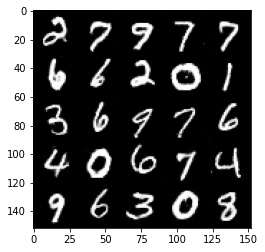

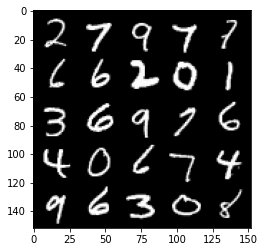

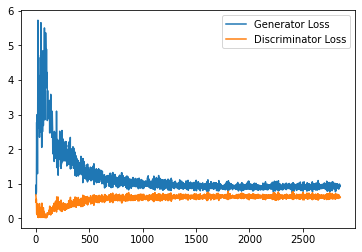

Step 57500: Generator loss: 0.9198907901048661, discriminator loss: 0.6229242539405823


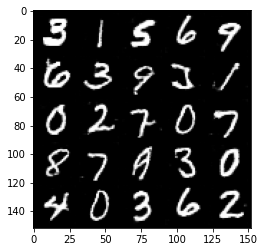

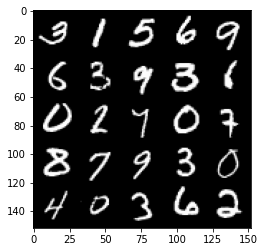

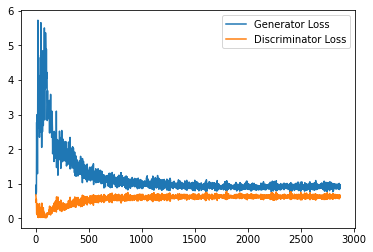

Step 58000: Generator loss: 0.9284476655721664, discriminator loss: 0.6206404943466186


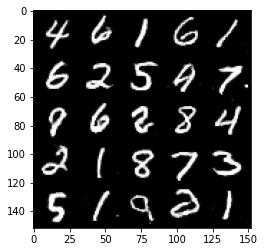

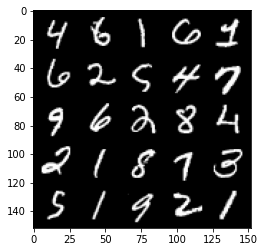

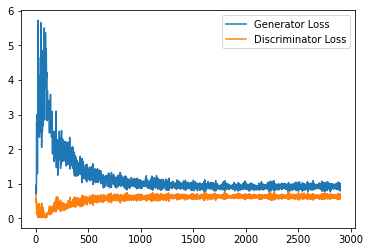

Step 58500: Generator loss: 0.931602325797081, discriminator loss: 0.6144073197841644


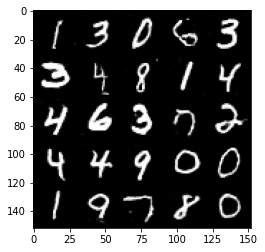

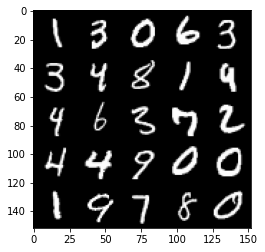

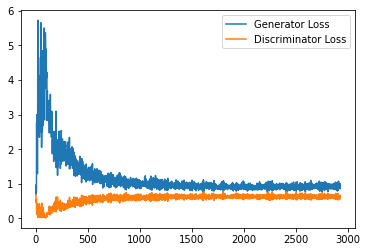

Step 59000: Generator loss: 0.9206296548843383, discriminator loss: 0.6184658771157264


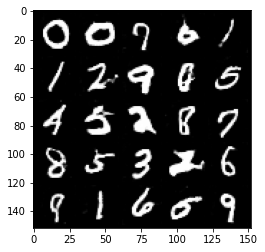

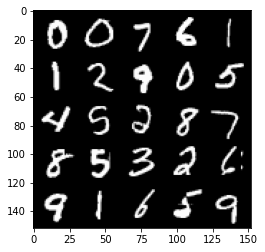

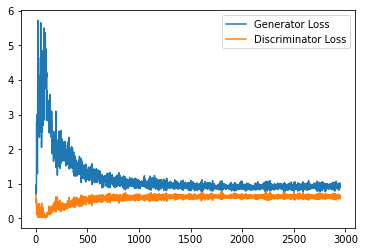

Step 59500: Generator loss: 0.9182177748680115, discriminator loss: 0.6205827633738518


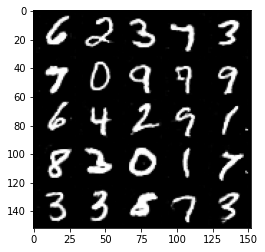

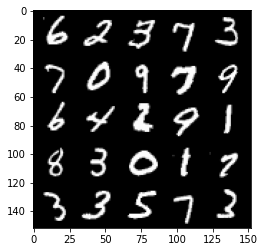

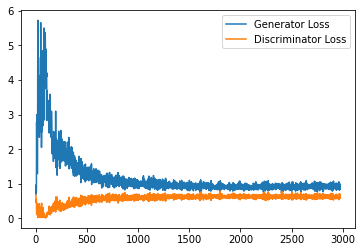

Step 60000: Generator loss: 0.9368694318532944, discriminator loss: 0.613107794046402


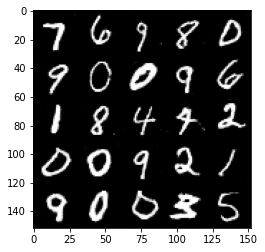

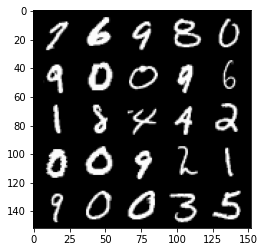

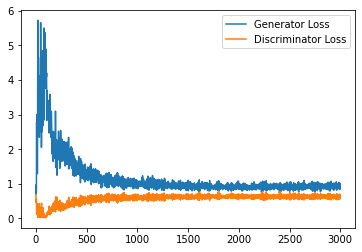

Step 60500: Generator loss: 0.9134057904481888, discriminator loss: 0.6221793654561043


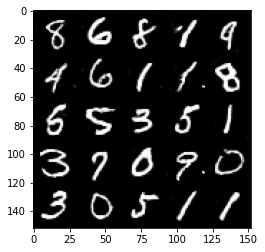

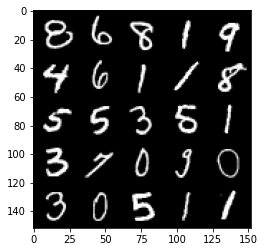

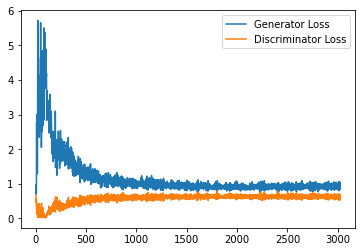

Step 61000: Generator loss: 0.9231677032709121, discriminator loss: 0.6118298009634018


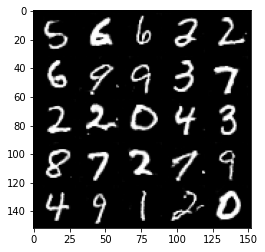

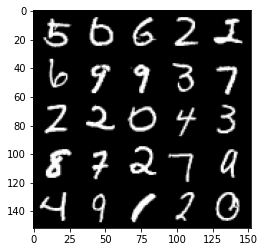

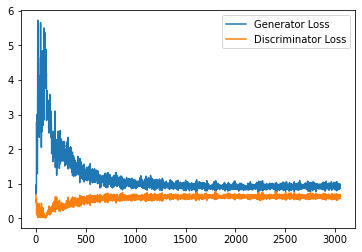

Step 61500: Generator loss: 0.9235254868268966, discriminator loss: 0.615717760026455


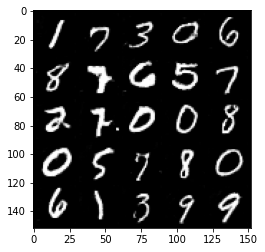

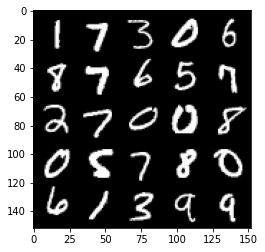

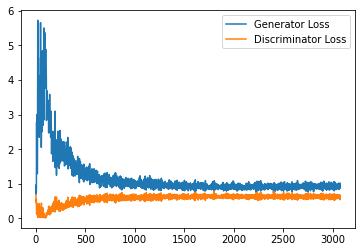

Step 62000: Generator loss: 0.9213291077613831, discriminator loss: 0.613233573436737


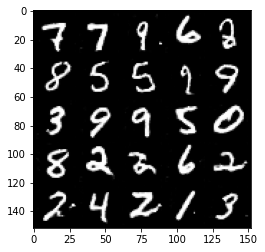

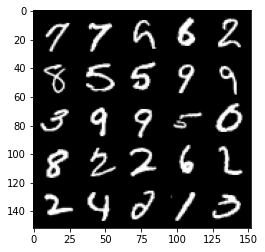

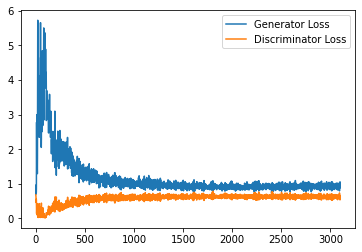

Step 62500: Generator loss: 0.9420749269723893, discriminator loss: 0.615205597937107


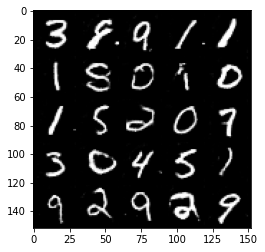

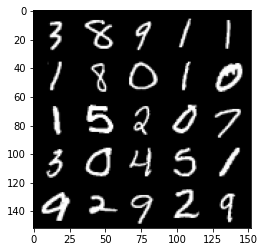

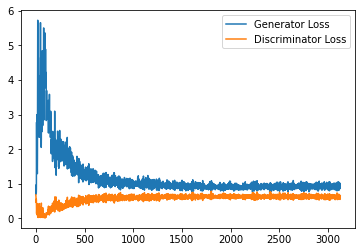

Step 63000: Generator loss: 0.9137497168779373, discriminator loss: 0.620602588057518


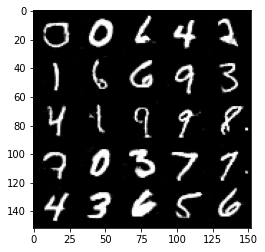

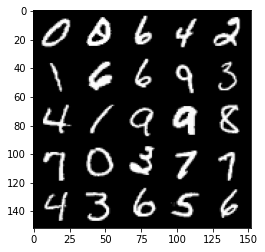

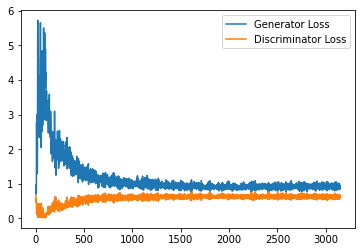

Step 63500: Generator loss: 0.9330543782711029, discriminator loss: 0.6113992164134979


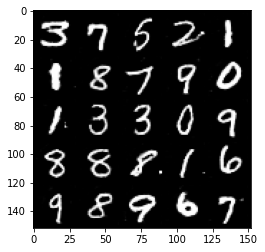

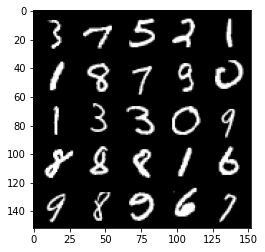

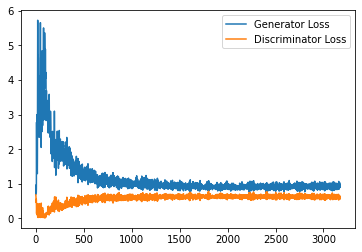

Step 64000: Generator loss: 0.9327148735523224, discriminator loss: 0.613626140654087


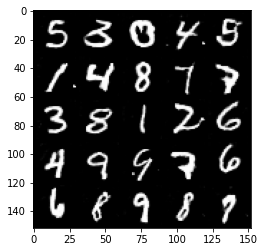

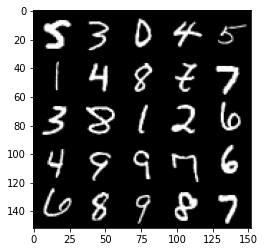

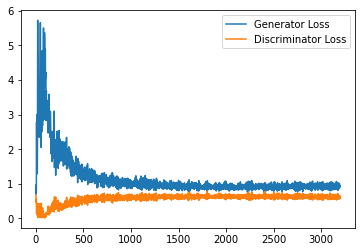

Step 64500: Generator loss: 0.9353716605901718, discriminator loss: 0.6131951683163643


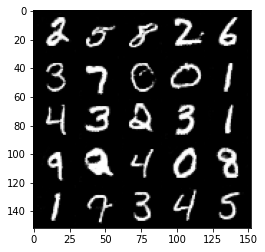

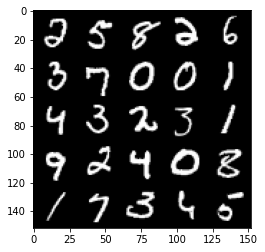

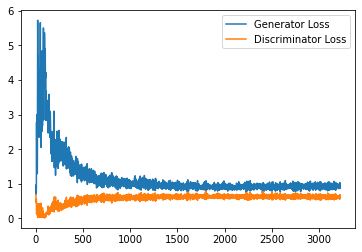

Step 65000: Generator loss: 0.9355811568498611, discriminator loss: 0.6166220635175705


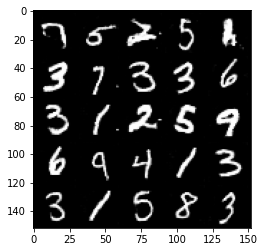

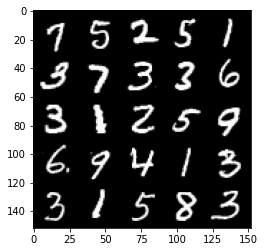

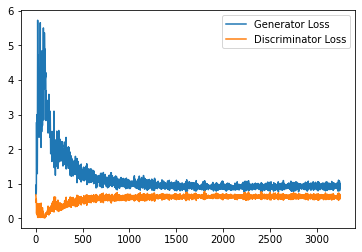

Step 65500: Generator loss: 0.9155497243404388, discriminator loss: 0.6181910440921784


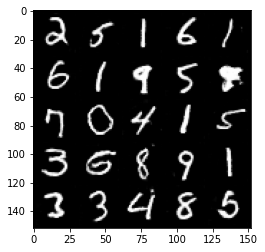

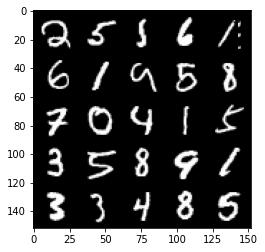

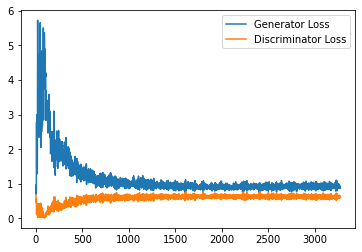

Step 66000: Generator loss: 0.9192908158302308, discriminator loss: 0.6134811366796493


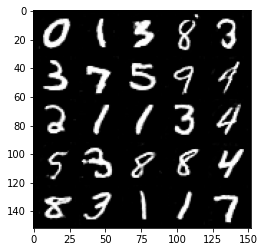

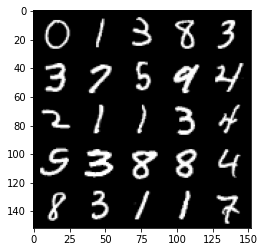

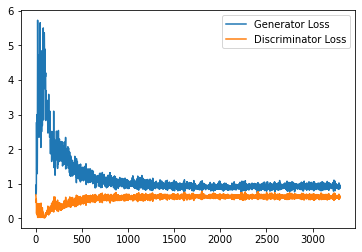

Step 66500: Generator loss: 0.9497405924797058, discriminator loss: 0.6129599075913429


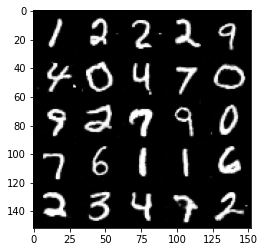

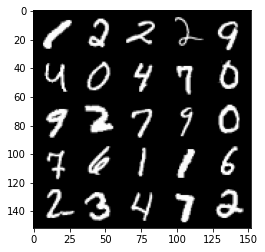

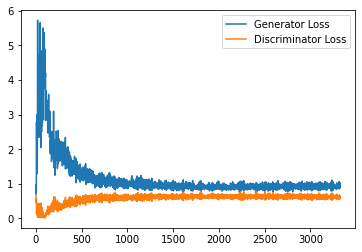

Step 67000: Generator loss: 0.9415074726343154, discriminator loss: 0.6184467551708221


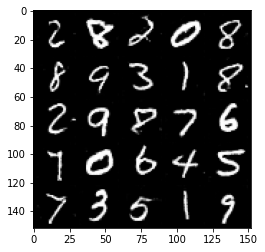

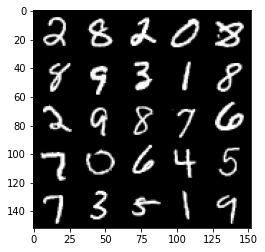

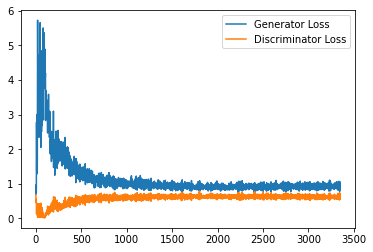

Step 67500: Generator loss: 0.9435018906593323, discriminator loss: 0.6136586475372314


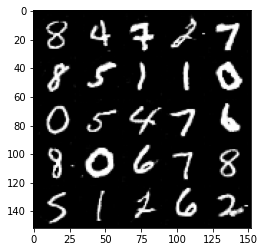

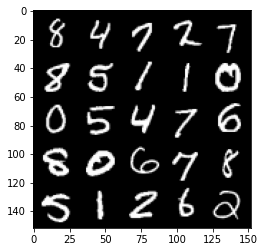

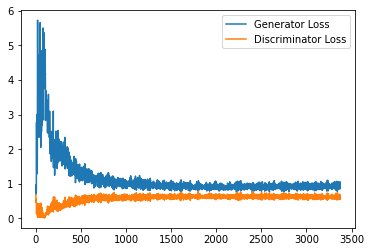

Step 68000: Generator loss: 0.944337898850441, discriminator loss: 0.6153897302746772


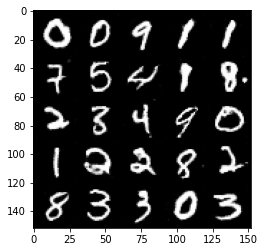

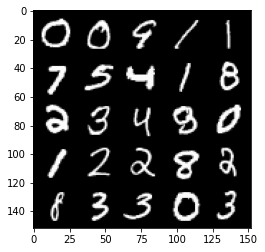

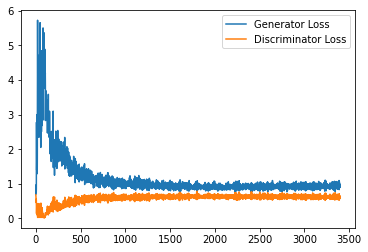

Step 68500: Generator loss: 0.937057389497757, discriminator loss: 0.6130601369142532


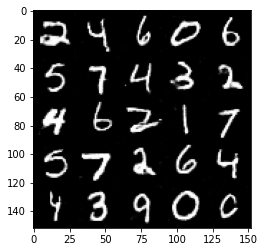

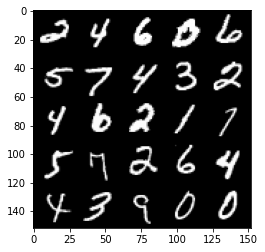

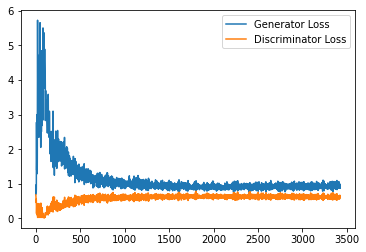

Step 69000: Generator loss: 0.9513250123262406, discriminator loss: 0.6110019577741623


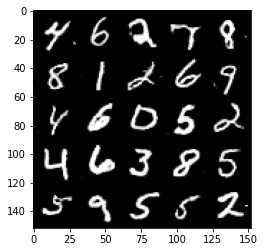

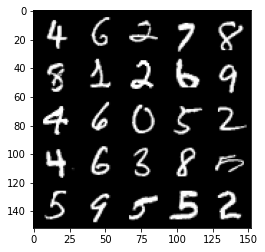

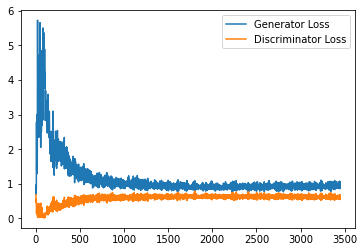

Step 69500: Generator loss: 0.9346905510425567, discriminator loss: 0.6130493779182434


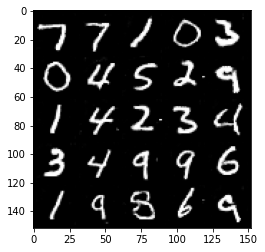

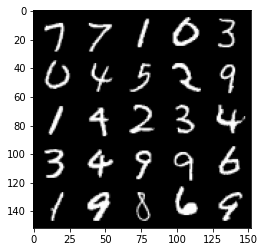

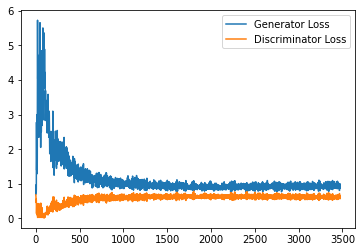

Step 70000: Generator loss: 0.9442709541320801, discriminator loss: 0.6062049045562744


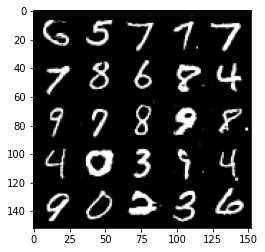

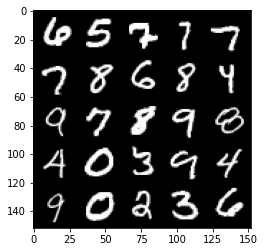

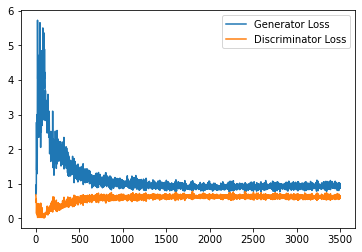

Step 70500: Generator loss: 0.9401715826988221, discriminator loss: 0.6099260002374649


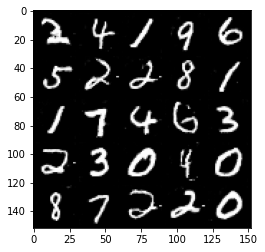

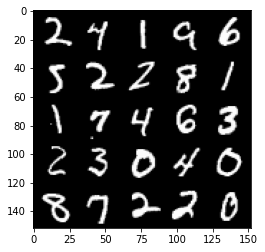

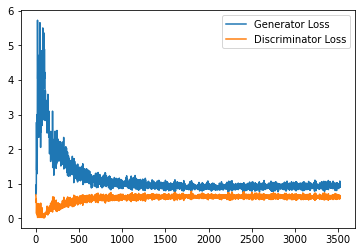

Step 71000: Generator loss: 0.9519088451862335, discriminator loss: 0.6059042220711708


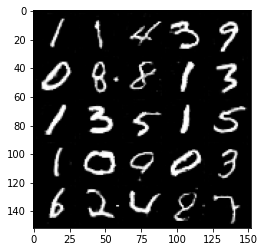

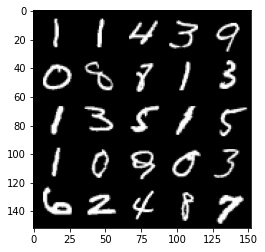

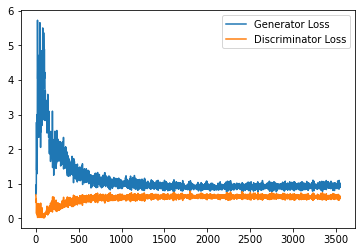

Step 71500: Generator loss: 0.953359934926033, discriminator loss: 0.6071968703866005


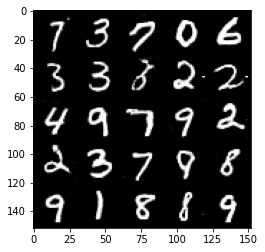

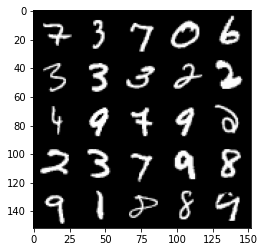

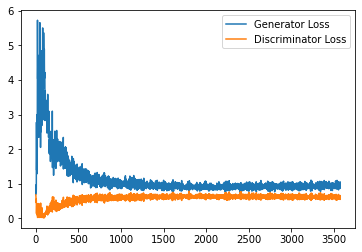

Step 72000: Generator loss: 0.9619681786298752, discriminator loss: 0.6129857697486878


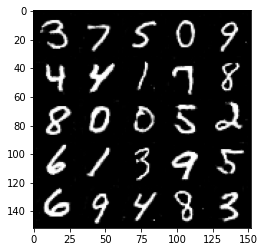

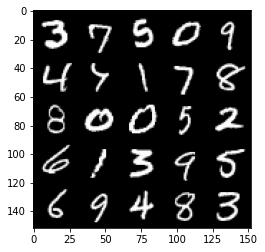

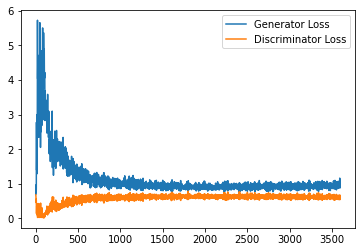

Step 72500: Generator loss: 0.9519761120080947, discriminator loss: 0.6062635498642921


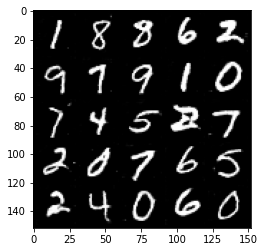

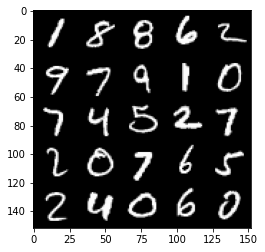

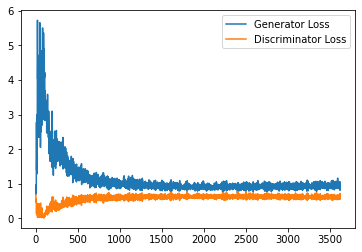

Step 73000: Generator loss: 0.9414542001485825, discriminator loss: 0.6110014216303825


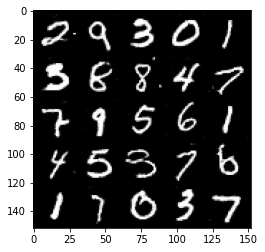

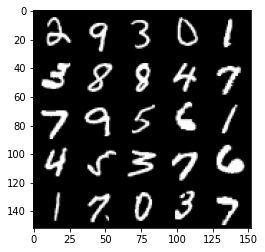

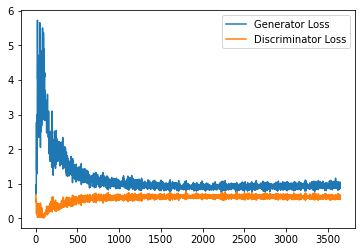

Step 73500: Generator loss: 0.9528251422643661, discriminator loss: 0.6008524885773658


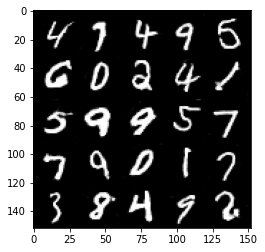

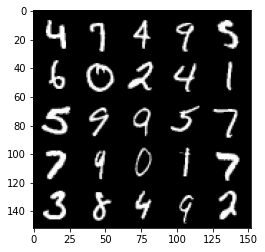

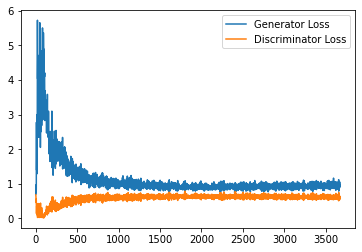

Step 74000: Generator loss: 0.9459445713758469, discriminator loss: 0.6081629307866097


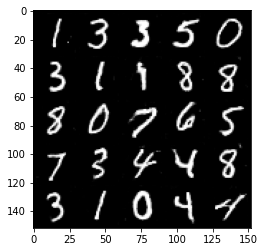

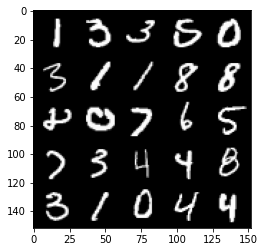

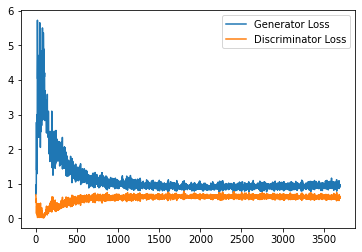

Step 74500: Generator loss: 0.955803671836853, discriminator loss: 0.6026201766133309


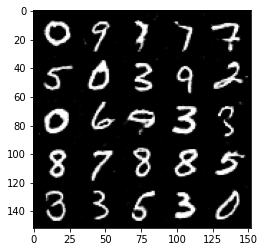

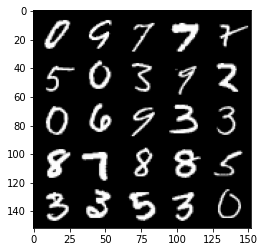

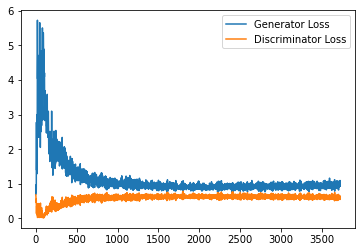

Step 75000: Generator loss: 0.9546876480579376, discriminator loss: 0.6053328776359558


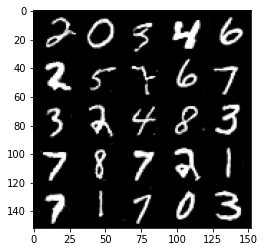

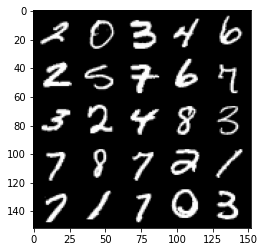

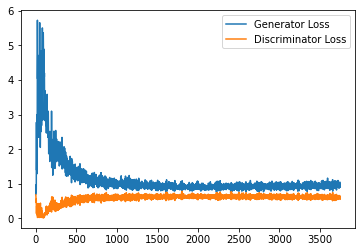

Step 75500: Generator loss: 0.9469921054840088, discriminator loss: 0.6050479414463044


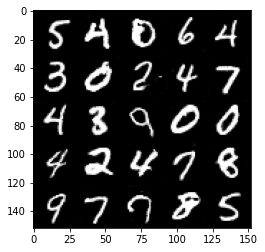

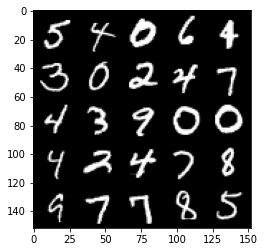

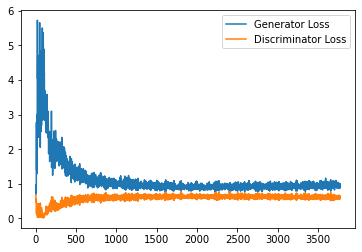

Step 76000: Generator loss: 0.9596896834373474, discriminator loss: 0.6085261843204498


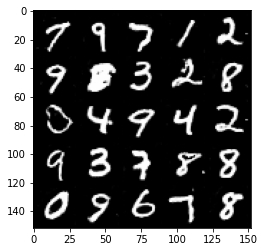

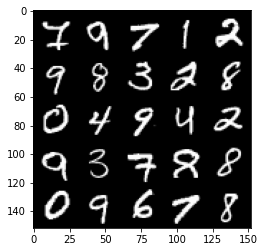

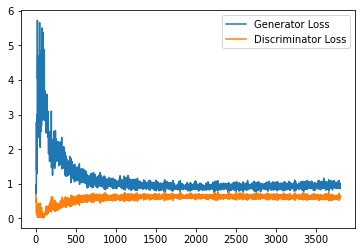

Step 76500: Generator loss: 0.9496782519817353, discriminator loss: 0.607687649011612


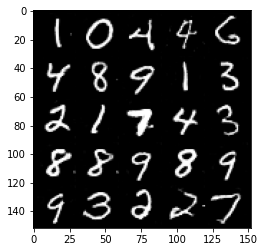

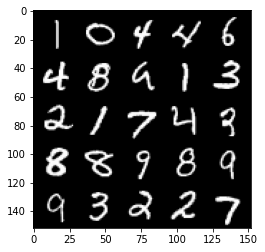

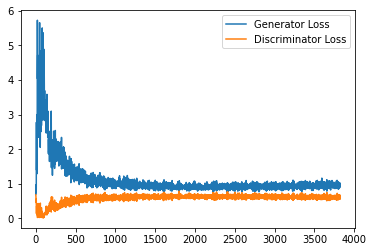

Step 77000: Generator loss: 0.9526974676847458, discriminator loss: 0.603604730129242


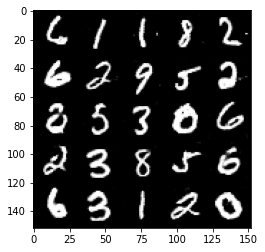

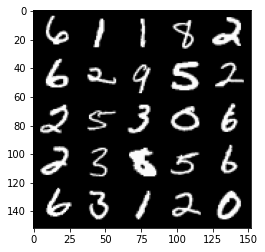

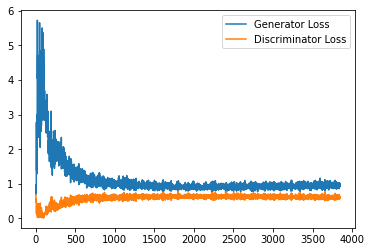

Step 77500: Generator loss: 0.957502052783966, discriminator loss: 0.6077925420999527


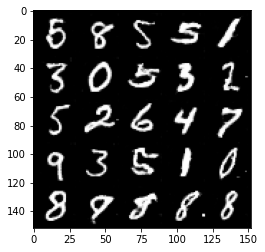

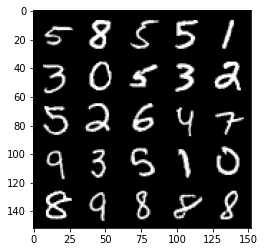

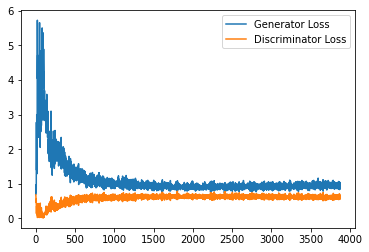

Step 78000: Generator loss: 0.9601128642559051, discriminator loss: 0.602923222064972


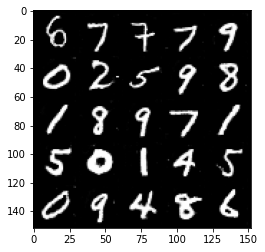

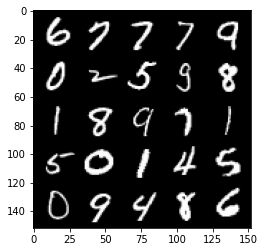

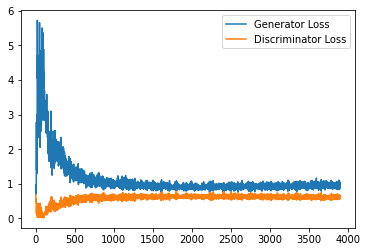

Step 78500: Generator loss: 0.9523875813484192, discriminator loss: 0.6034089543819428


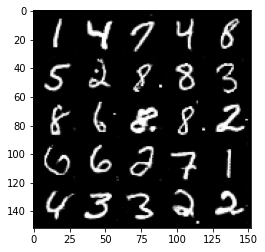

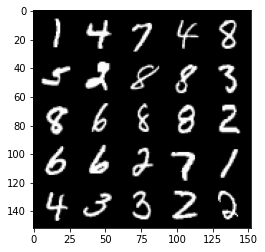

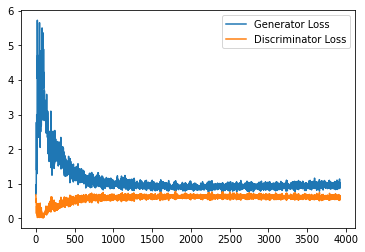

Step 79000: Generator loss: 0.9588296966552734, discriminator loss: 0.6031082344055175


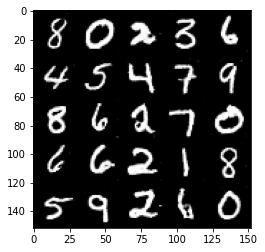

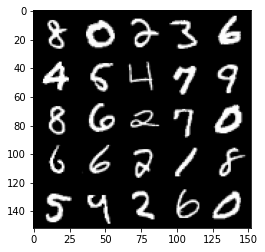

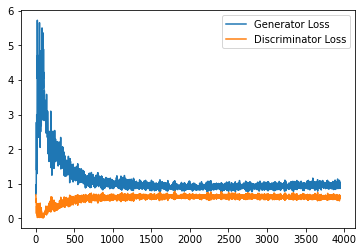

Step 79500: Generator loss: 0.9692973929643631, discriminator loss: 0.6091901553273201


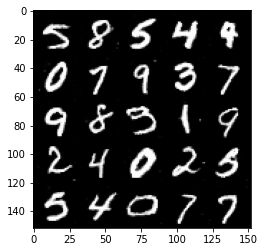

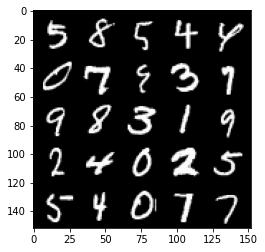

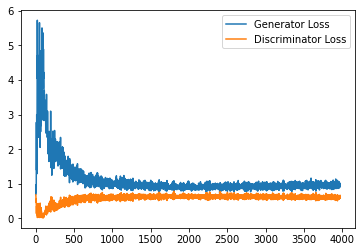

Step 80000: Generator loss: 0.9453593434095383, discriminator loss: 0.6082994982600212


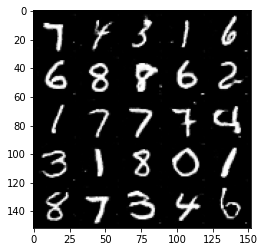

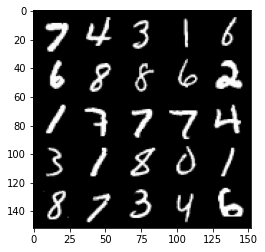

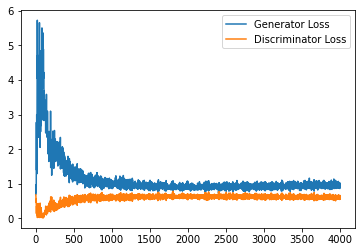

Step 80500: Generator loss: 0.9587080518007278, discriminator loss: 0.6019872053861618


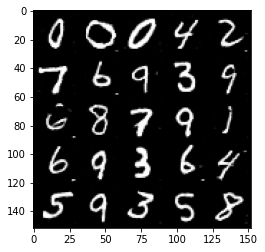

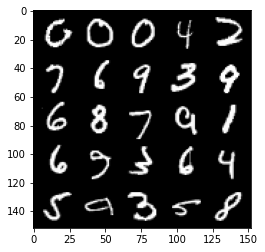

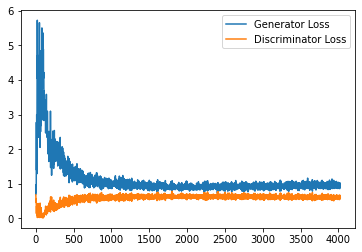

Step 81000: Generator loss: 0.9626814732551575, discriminator loss: 0.6003211797475815


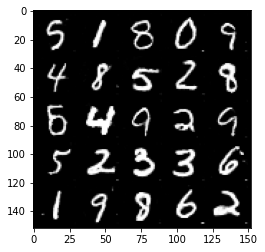

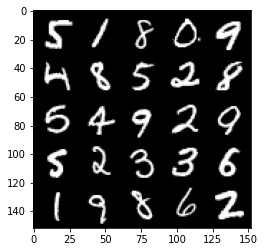

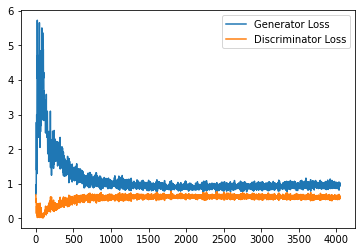

Step 81500: Generator loss: 0.9511880812644958, discriminator loss: 0.6081379984617233


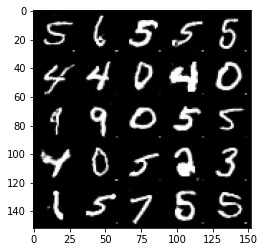

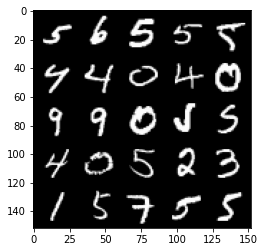

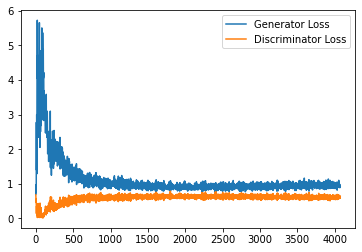

Step 82000: Generator loss: 0.9666391304731369, discriminator loss: 0.6070806802511215


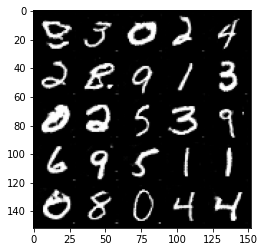

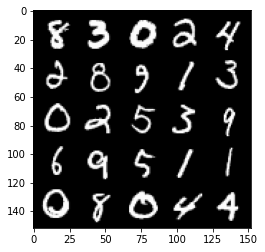

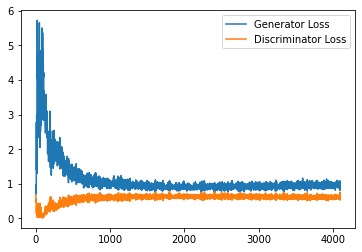

Step 82500: Generator loss: 0.9620040276050568, discriminator loss: 0.6049706355929375


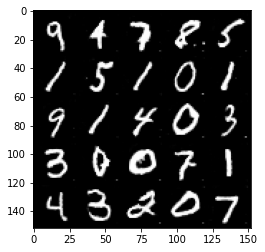

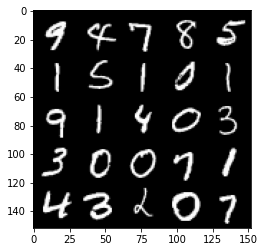

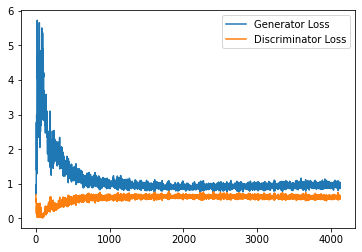

Step 83000: Generator loss: 0.9625509747266769, discriminator loss: 0.5981182955503463


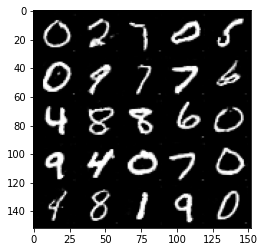

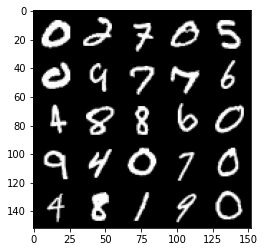

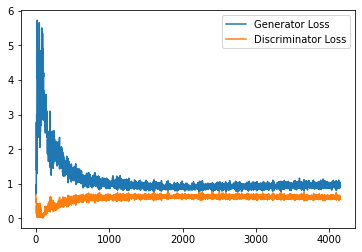

Step 83500: Generator loss: 0.961802871465683, discriminator loss: 0.6039800163507462


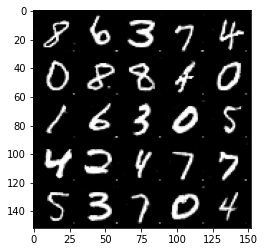

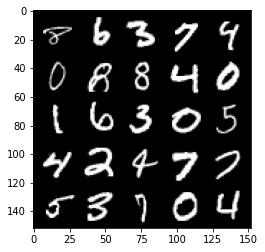

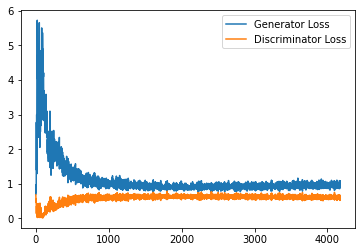

Step 84000: Generator loss: 0.9535811933279037, discriminator loss: 0.6087260003685951


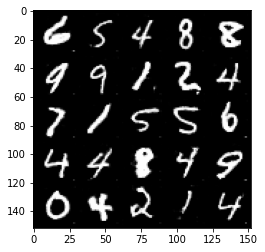

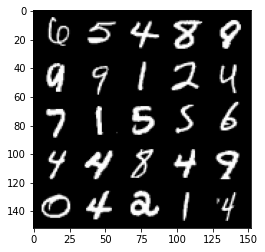

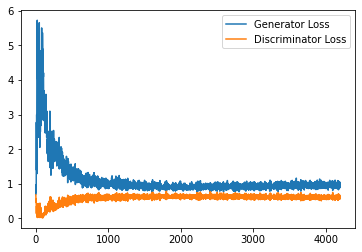

Step 84500: Generator loss: 0.9671412214040757, discriminator loss: 0.6008134061098098


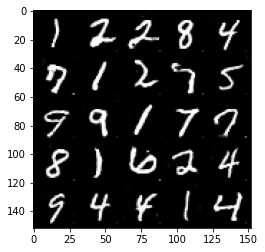

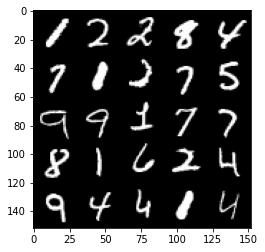

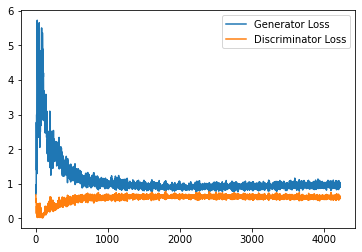

Step 85000: Generator loss: 0.9545701955556869, discriminator loss: 0.6069992437958718


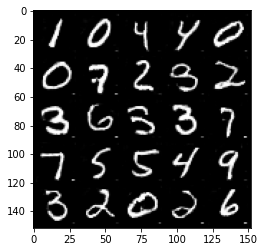

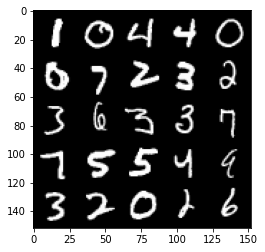

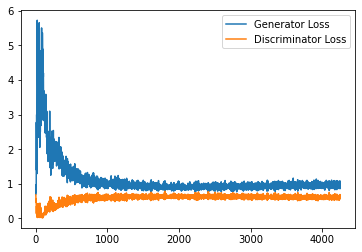

Step 85500: Generator loss: 0.9637374103069305, discriminator loss: 0.5981398713588715


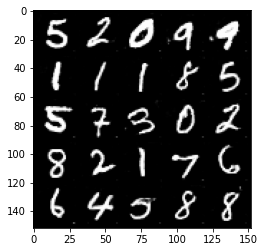

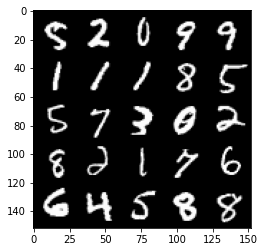

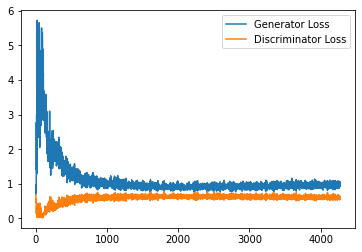

Step 86000: Generator loss: 0.9693069870471954, discriminator loss: 0.6064725474119187


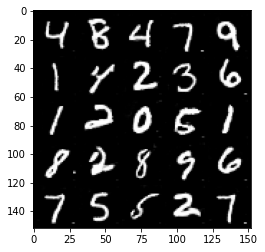

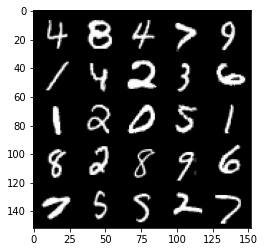

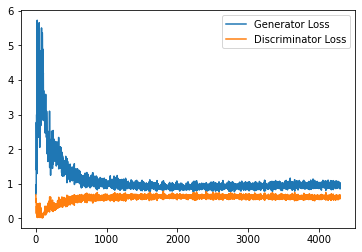

Step 86500: Generator loss: 0.9610054565668106, discriminator loss: 0.6045934959053993


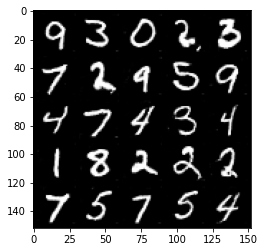

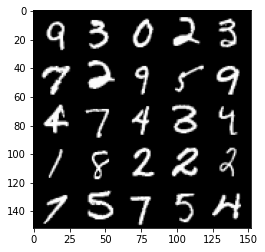

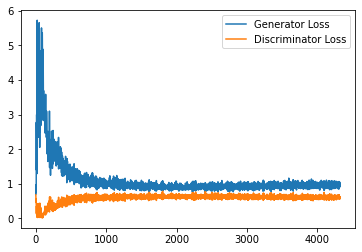

Step 87000: Generator loss: 0.9694456893205643, discriminator loss: 0.6053202199935913


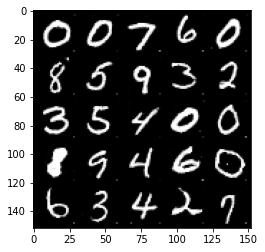

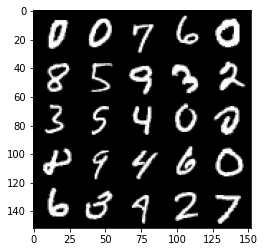

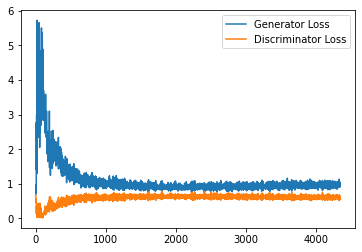

Step 87500: Generator loss: 0.9652845249176025, discriminator loss: 0.6026487954854965


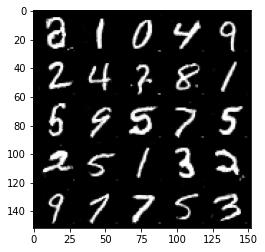

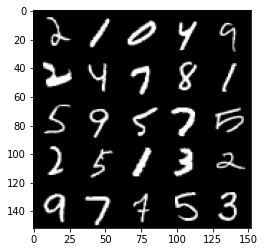

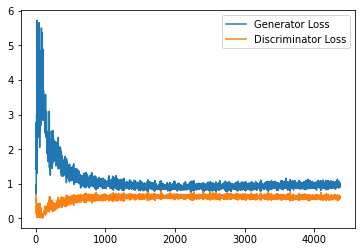

Step 88000: Generator loss: 0.9607085120677948, discriminator loss: 0.6068880639076233


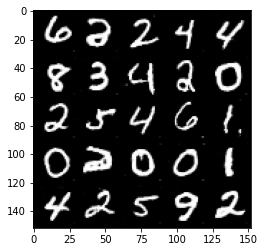

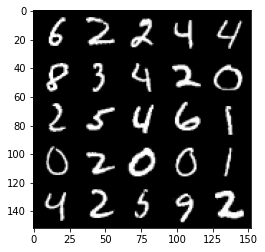

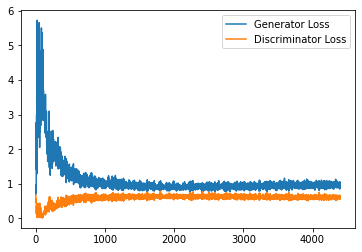

Step 88500: Generator loss: 0.9571365818977356, discriminator loss: 0.6014427807927132


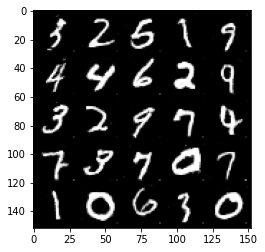

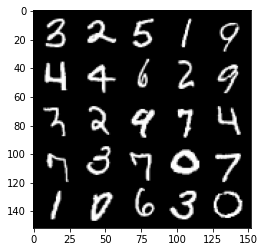

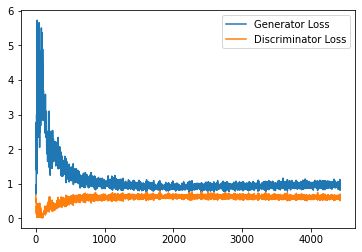

Step 89000: Generator loss: 0.9635604021549224, discriminator loss: 0.6074984178543091


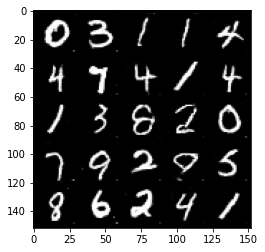

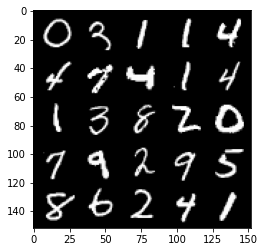

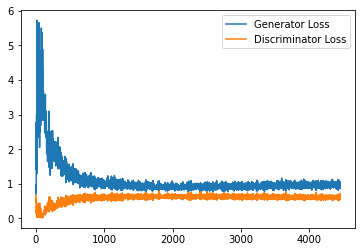

Step 89500: Generator loss: 0.9515264197587967, discriminator loss: 0.6026961240172386


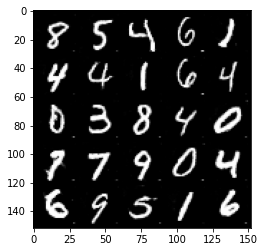

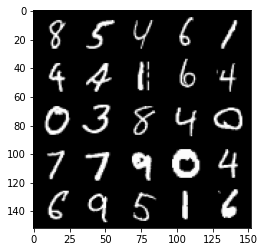

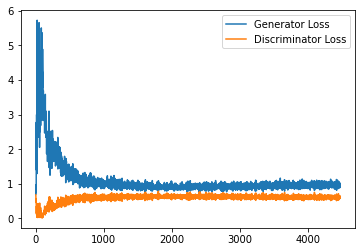

Step 90000: Generator loss: 0.9657124277353287, discriminator loss: 0.6034502164125443


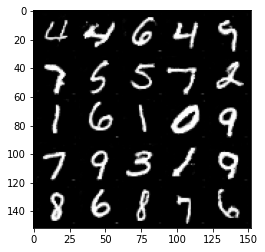

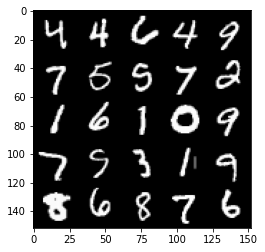

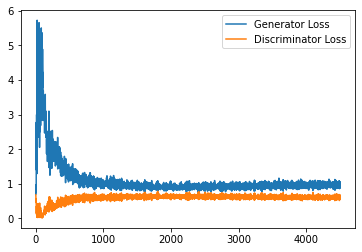

Step 90500: Generator loss: 0.9738570450544357, discriminator loss: 0.6021355067491532


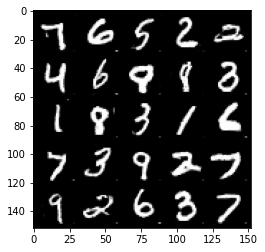

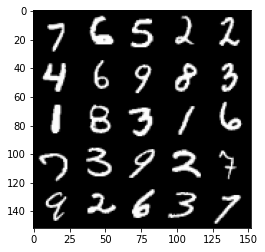

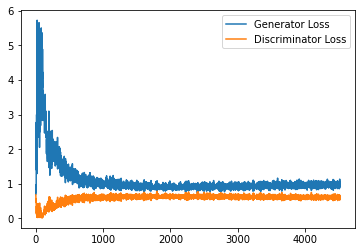

Step 91000: Generator loss: 0.9550824480056763, discriminator loss: 0.6040741900205612


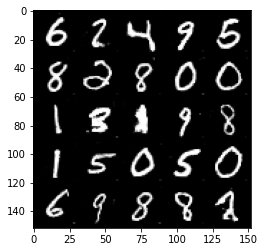

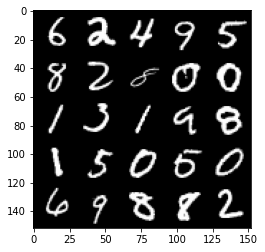

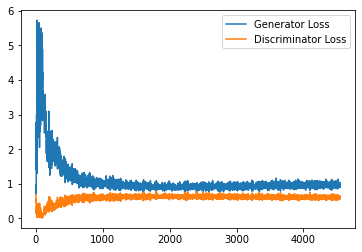

Step 91500: Generator loss: 0.9839459785223007, discriminator loss: 0.6011296170949936


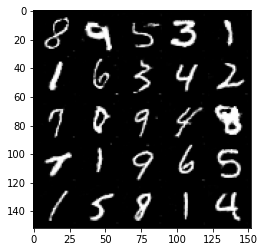

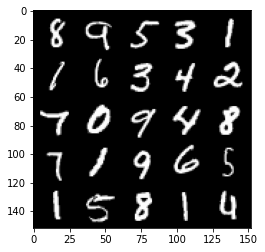

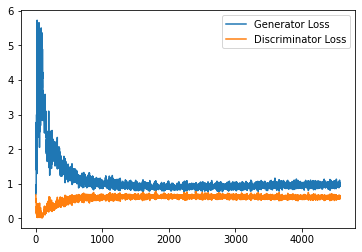

Step 92000: Generator loss: 0.9719802590608597, discriminator loss: 0.6058380694389344


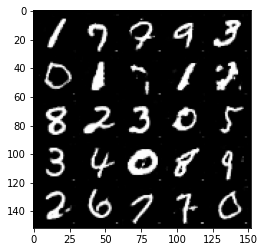

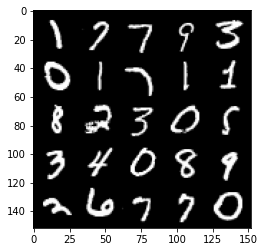

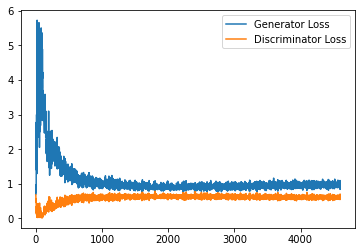

Step 92500: Generator loss: 0.9767312771081924, discriminator loss: 0.5986944437026978


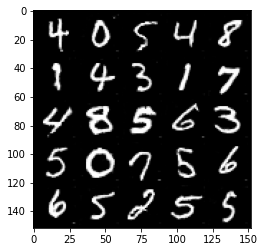

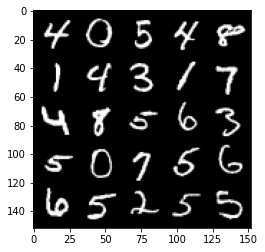

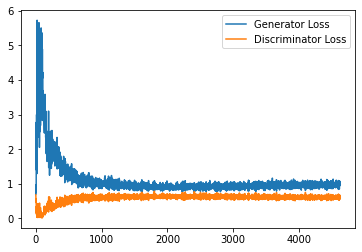

Step 93000: Generator loss: 0.9759186609983445, discriminator loss: 0.6027752258777619


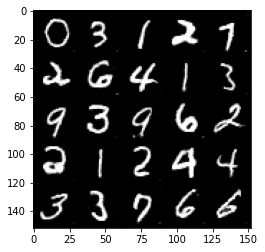

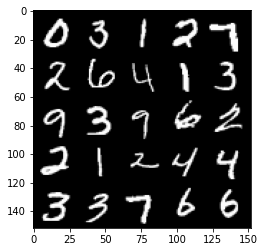

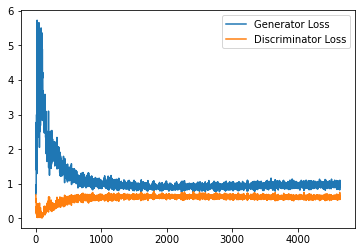

Step 93500: Generator loss: 0.9751317248344421, discriminator loss: 0.6020181793570518


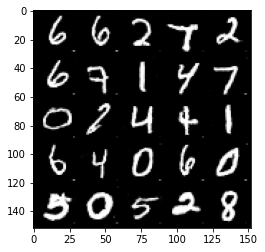

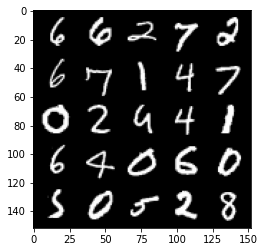

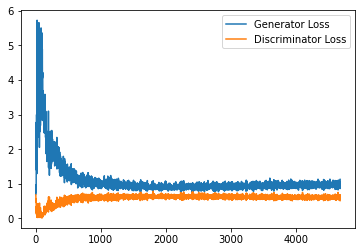

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

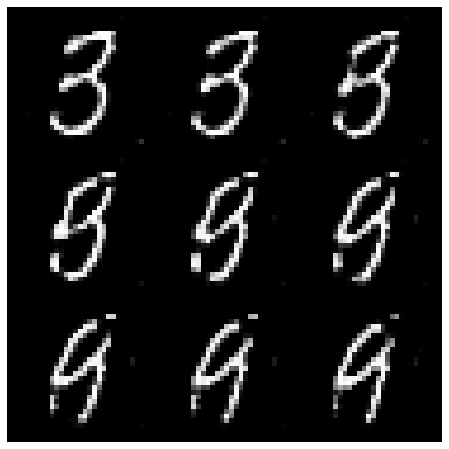

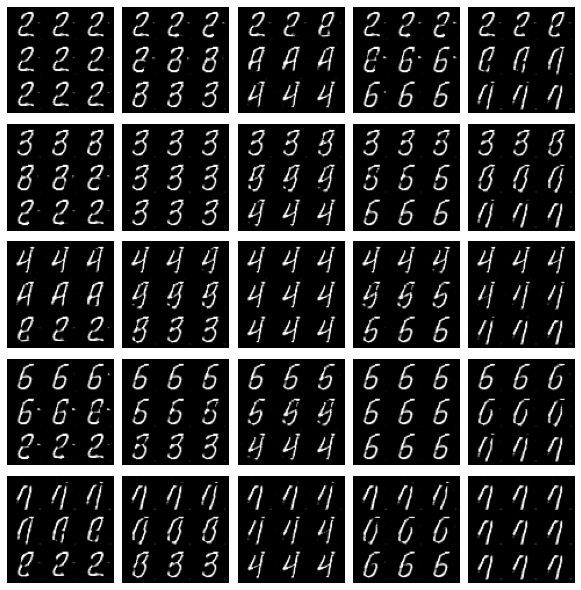

In [15]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 3 # Choose the start digit
### Change me! ###
end_plot_number = 9 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

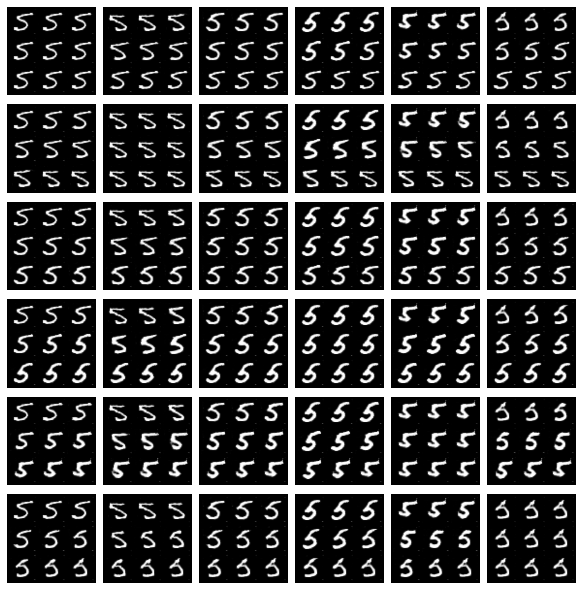

In [16]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 6 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()